In [45]:
# Importación de librerías
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Definición de la función general para mostrar imagenes genéricas
def imshow(title, img, size=6):
    plt.figure(figsize=(size, size))
    # Antes de mostrar la imagen se verifica el número de canales
    if len(img.shape) == 2:
        plt.imshow(img, cmap="gray")
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")
    plt.show()

In [46]:
#Detección de círculos y evaluación
def find_edges(img):
    # --- Convertir a escala de grises ---
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # --- Suavizar ---
    blur = cv2.GaussianBlur(gray, (7, 7), 0)

    # --- Bordes ---
    edges = cv2.Canny(blur, 50, 150)
    #imshow("Bordes (Canny) con suavizado", edges)

    # --- Cerrar huecos para que el contorno sea más sólido ---
    kernel = np.ones((5, 5), np.uint8)
    edges_dil_blur = cv2.dilate(edges, kernel, iterations=2)
    #imshow("Bordes dilatados", edges_dil_blur)
    # --- Buscar contornos ---
    contours, _ = cv2.findContours(edges_dil_blur, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # --- Seleccionar el contorno más grande ---
    blister_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(blister_contour)
    
    # Máscara del blister
    blister_mask_full = np.zeros_like(gray)
    cv2.drawContours(blister_mask_full, [blister_contour], -1, 255, -1)
    #imshow("Máscara del blister (en la imagen completa)", blister_mask_full)
    # Recorte del blister
    blister_crop = img[y:y+h, x:x+w]
    gray_blister = blur[y:y+h, x:x+w]

    # Contraste adaptativo CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    gray_blister_clahe = clahe.apply(gray_blister)

    altura_ref = 200  # píxeles, ejemplo
    h, w = gray_blister.shape[:2]
    factor = altura_ref / h
    gray_blister_clahe = cv2.resize(gray_blister, (int(w*factor), altura_ref))
    blister_crop = cv2.resize(blister_crop, (int(w*factor), altura_ref))

    return gray_blister_clahe, blister_crop

In [47]:
def clasificar(gray_blister_clahe, circles):
    umbral_frac_claro = 0.22  # fracción mínima de píxeles claros para considerar pastilla completa
    umbral_intensidad_claro = 150  # intensidad a partir de la cual consideramos "claro"

    resultados_2 = []

    for i, (x_c, y_c, r_c) in enumerate(circles):
        mask = np.zeros_like(gray_blister_clahe)
        cv2.circle(mask, (x_c, y_c), r_c - 3, 255, -1)
        
        region = gray_blister_clahe[mask == 255]


        # ---- Histograma ----
        hist, bins = np.histogram(region, bins=256, range=(0,255))
    
        # Calcular fracción de píxeles "claros"
        pix_claros = np.sum(hist[umbral_intensidad_claro:])
        fraccion_claros = pix_claros / region.size

        # ---- Regla ----
        if fraccion_claros > umbral_frac_claro:
            estado = "completa"
        #elif fraccion_claros > 0.2:
            #estado = "pastilla parcial / rota"
        else:
            estado = "vacía"
            

        resultados_2.append({
            "x": int(x_c),
            "y": int(y_c),
            "r": int(r_c),
            "fraccion_claros": float(fraccion_claros),
            "estado": estado
        })
    return resultados_2


In [48]:
def pastillas_ordendas(resultados_2):

    num_columnas = 5
    num_filas = 2   # porque son 10 pastillas
    print("\n--- Blister ordenado 5x2 (solo visualización) ---\n")
    index = 0
    for fila in range(num_filas):
        fila_texto = []
        for col in range(num_columnas):
            if index < len(resultados_2):
                estado = resultados_2[index]["estado"]
                fila_texto.append(f"{estado}")
            else:
                fila_texto.append("—")
            index += 1
        
        print(f"Fila {fila+1}: {fila_texto}")

In [ ]:
def rotas_incompletas(resultados_2,gray_blister_clahe):
    # Parámetros HoughLinesP
    min_line_length = 12
    max_line_gap =6
    threshold_hough = 20

    # Recorrer todas las pastillas
    for i, r_dict in enumerate(resultados_2):
        # Saltar pastillas vacías
        if r_dict['estado'] == 'vacía':
            continue

        x_c, y_c, r_c = r_dict["x"], r_dict["y"], r_dict["r"]

        # Máscara circular
        mask = np.zeros_like(gray_blister_clahe, dtype=np.uint8)
        cv2.circle(mask, (x_c, y_c), r_c - 12, 255, -1)

        # Extraer región
        region = cv2.bitwise_and(gray_blister_clahe, gray_blister_clahe, mask=mask)

        # Recortar bounding box
        x1, y1 = max(x_c - r_c, 0), max(y_c - r_c, 0)
        x2, y2 = min(x_c + r_c, gray_blister_clahe.shape[1]-1), min(y_c + r_c, gray_blister_clahe.shape[0]-1)
        roi = region[y1:y2, x1:x2]

        # Bordes con Canny
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(4,4))
        roi_clahe = clahe.apply(roi)
        roi_blur = cv2.GaussianBlur(roi, (3,3), 0)
        roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
        edges = cv2.Canny(roi_clahe, 50, 150)

        # Detectar líneas
        lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=threshold_hough,
                                minLineLength=min_line_length, maxLineGap=max_line_gap)

        # Convertir ROI a color para dibujar líneas
        roi_color = cv2.cvtColor(roi, cv2.COLOR_GRAY2BGR)

        # Dibujar líneas detectadas
        if lines is not None:
            for x1l, y1l, x2l, y2l in lines[:,0]:
                cv2.line(roi_color, (x1l, y1l), (x2l, y2l), (255,0,0), 1)  # azul para que destaque
            r_dict["estado"] = "rota/incompleta"

        # ROTURAS MUY FINAS
        var_roi = np.var(roi[roi>0])
        bordes = np.sum(edges > 0)
        if var_roi > 100 and bordes > 20: # mucha varianza o bordes
            r_dict["estado"] = "rota/incompleta"

        # Mostrar con matplotlib
        #imshow(f"Pastilla {i+1} - {r_dict['estado']}", roi_color, size=4)
    return resultados_2
    

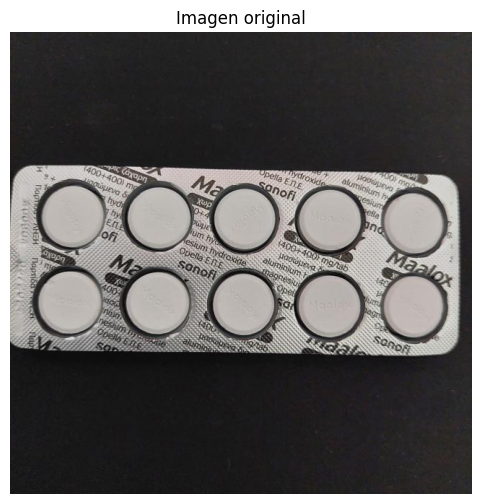

Resumen de 20250224_153124_jpg.rf.3847578dfd66b817407e466c7874943d.jpg: (0, 0)


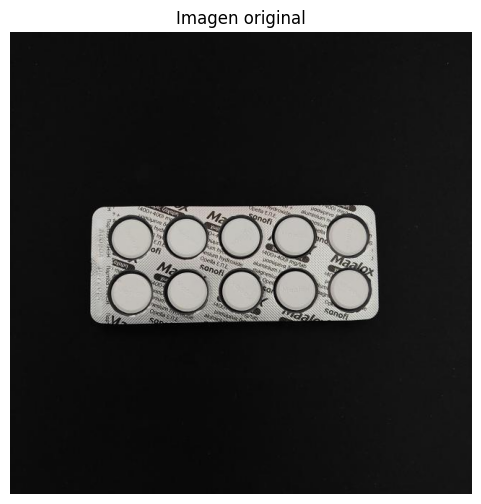

Resumen de 20250224_153131_jpg.rf.9c402a72bffe6d996dba78c04995142b.jpg: (0, 0)


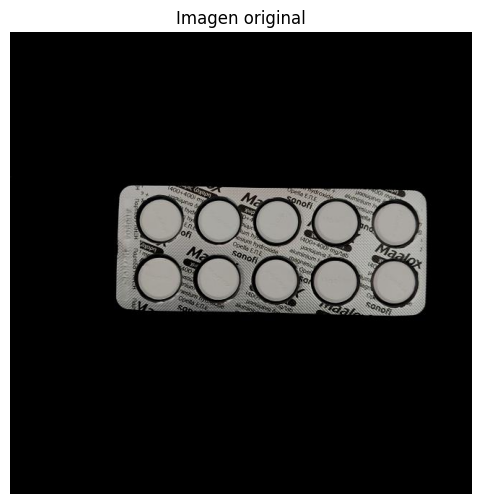

Resumen de 20250224_153224_jpg.rf.0fa68392afccda00f29f736c35fd06b7.jpg: (0, 0)


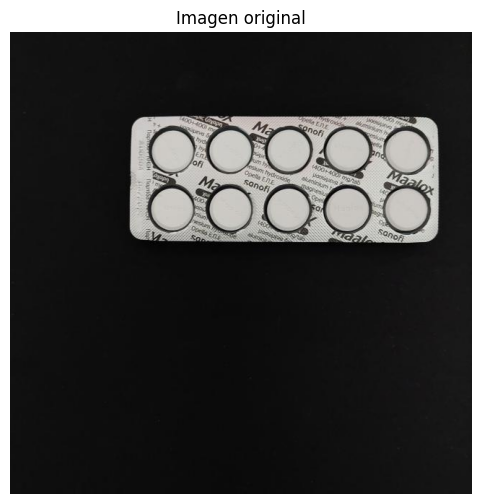

Resumen de 20250224_153235_jpg.rf.122631a9a7650595c374f26234d17b6b.jpg: (0, 0)


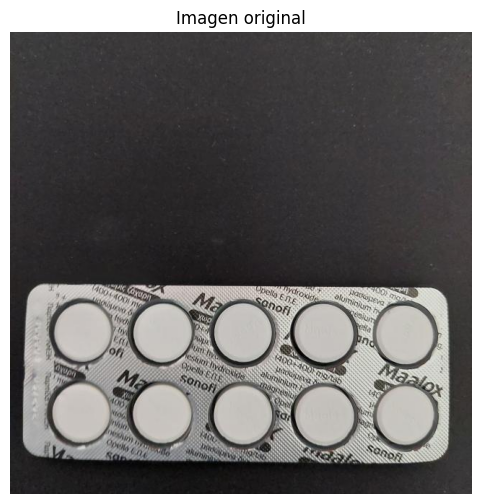

Resumen de 20250224_153255_jpg.rf.3c06ba6e010a146fe14a3a5508ab60f3.jpg: (0, 0)


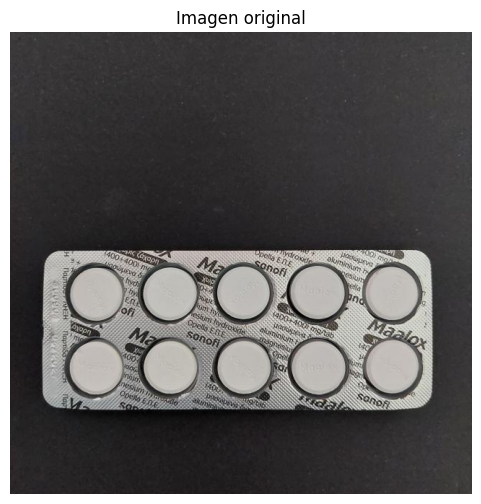

Resumen de 20250224_153309_jpg.rf.e9ce0a9dbd806d0c5fce17e530921049.jpg: (0, 0)


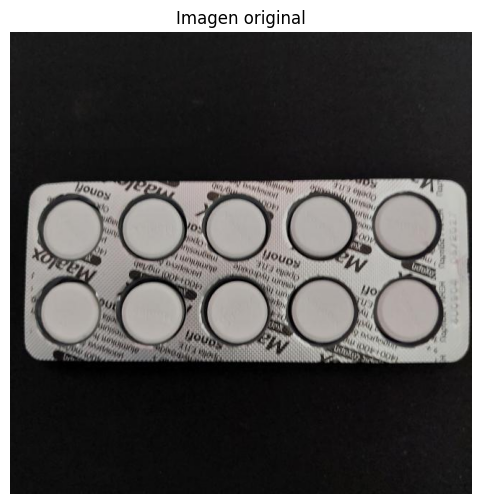

Resumen de 20250224_153536_jpg.rf.b90fee575e0bd8430c0c8fc9f5dade0e.jpg: (0, 0)


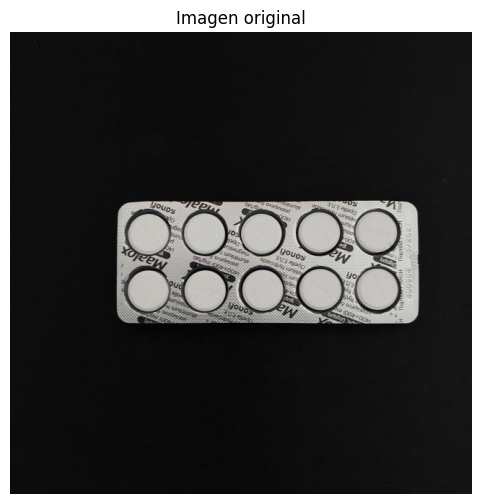

Resumen de 20250224_153550_jpg.rf.173fabce4a93e19216e722feba55baea.jpg: (0, 0)


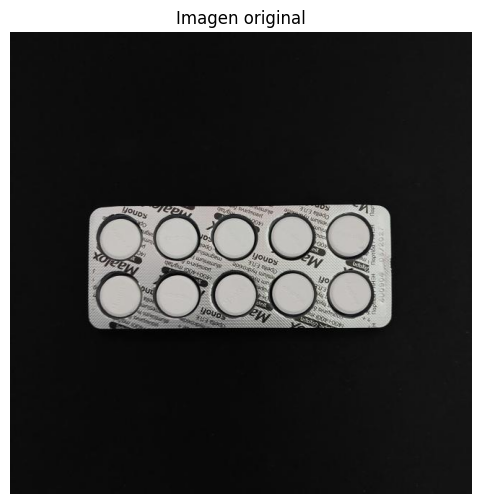

Resumen de 20250224_153552_jpg.rf.30ae352663aca0cbe82aaf29bc79ac9a.jpg: (0, 0)


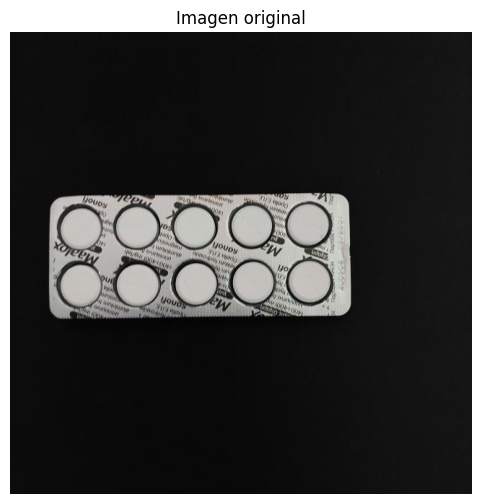

Resumen de 20250224_153554_jpg.rf.e37fba83d295614302716f5a6331f32d.jpg: (0, 0)


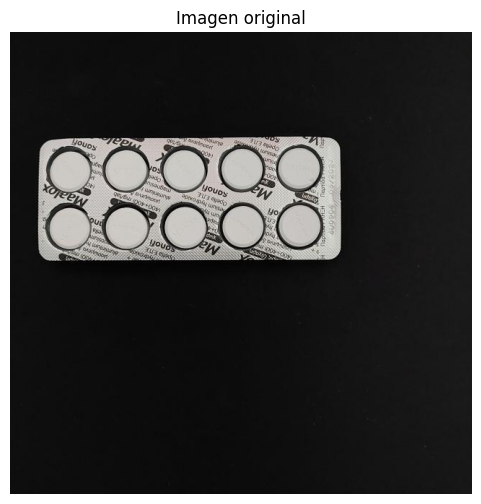

Resumen de 20250224_153556_jpg.rf.992185cb04c58d164a9d4023adf5cc6e.jpg: (0, 0)


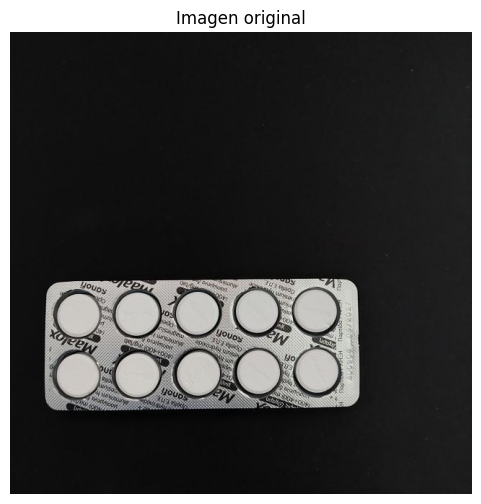

Resumen de 20250224_153602_jpg.rf.482dc789a565f0abe770156c5a574a6d.jpg: (0, 0)


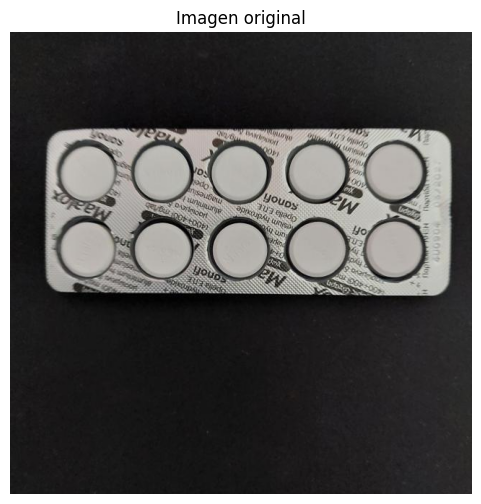

Resumen de 20250224_153609_jpg.rf.7e75454f40fea3a01319db8ab18f9274.jpg: (0, 0)


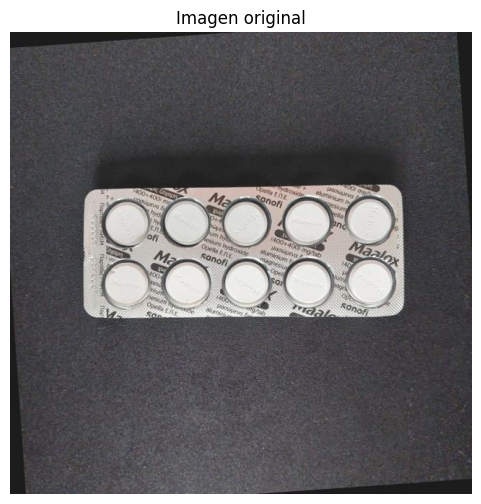

Resumen de 20250224_153840_jpg.rf.6b49a945278ed4010761d21d67165d46.jpg: (0, 0)


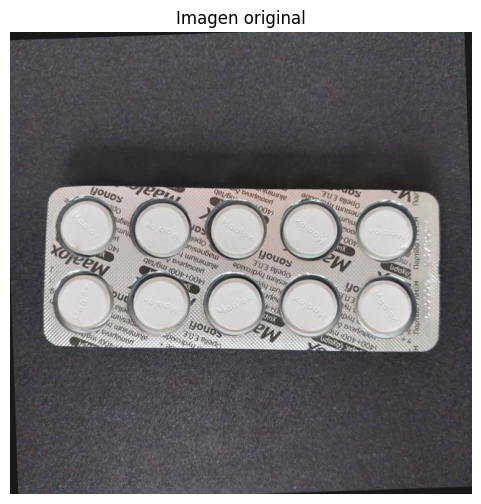

Resumen de 20250224_153904_jpg.rf.5275cb0dbc1085b0167e86e846ae4f3c.jpg: (0, 0)


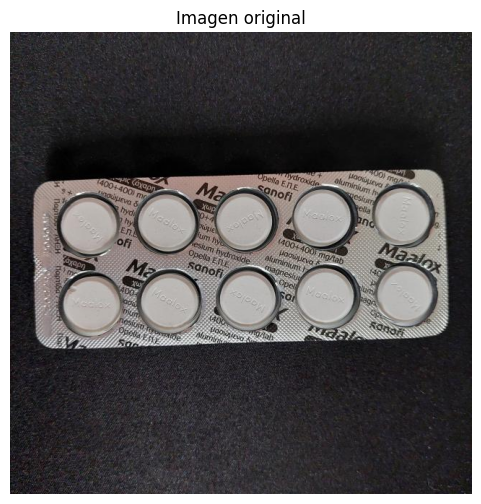

Resumen de 20250224_155804_jpg.rf.78db2607faf7d1e3436ca30c0e8522b0.jpg: (0, 6)


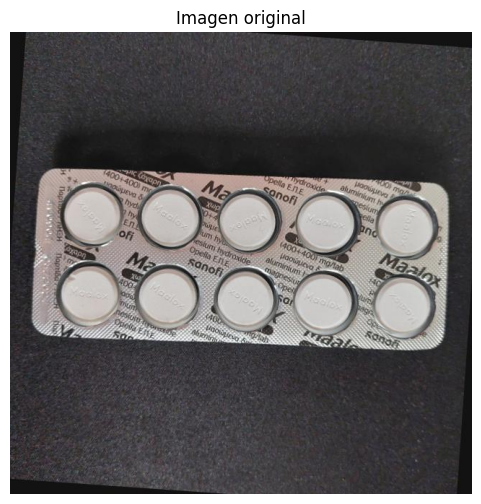

Resumen de 20250224_155804_jpg.rf.811657b022b706b29cd562a558ba1503.jpg: (0, 1)


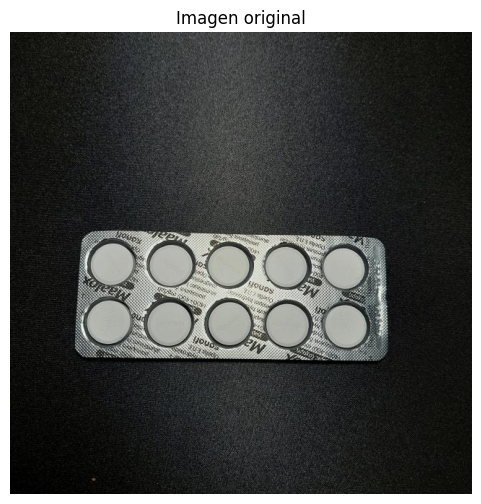

Resumen de 20250224_162133_jpg.rf.99df02cca8fc00e8728cf19dd9801c93.jpg: (0, 0)


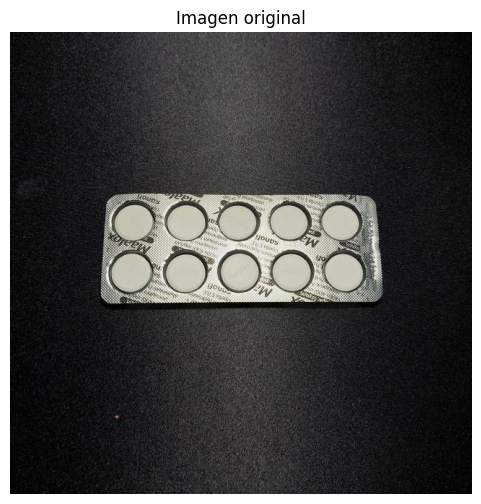

Resumen de 20250224_162139_jpg.rf.2c38053e427bc40ee19e01342f224532.jpg: (0, 0)


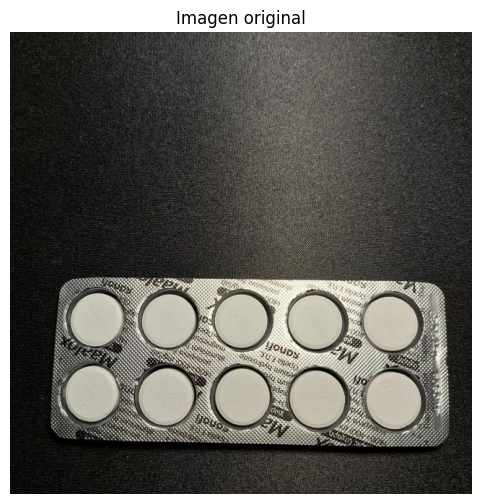

Resumen de 20250224_162154_jpg.rf.fed8f970380e36784e3e5b4adf7de2c3.jpg: (0, 0)


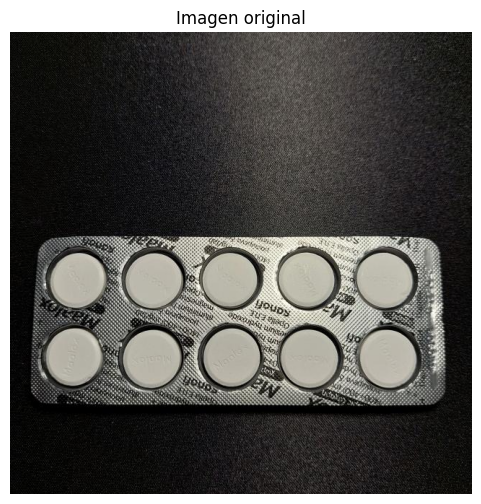

Resumen de 20250224_162158_jpg.rf.433034f16d7b7c2b373a1436e81c4b7a.jpg: (0, 0)


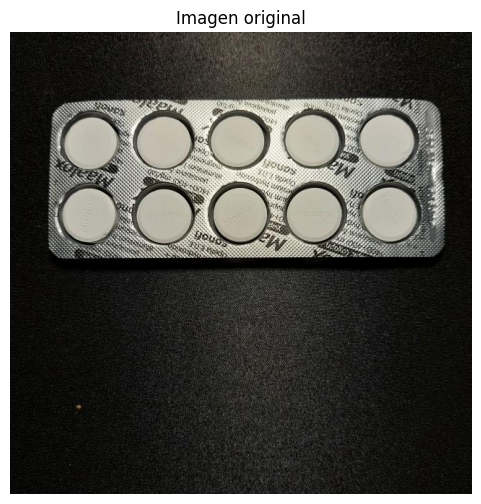

Resumen de 20250224_162205_jpg.rf.55dc24c9d9c67099904c3ca947b6584b.jpg: (0, 0)


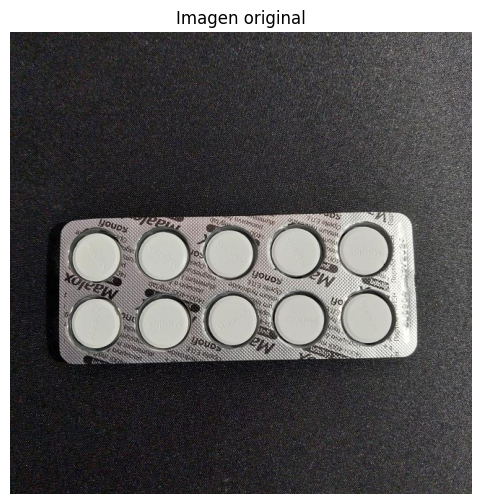

Resumen de 20250224_163018_jpg.rf.072156abdc74665ab231a0de0c39ec4a.jpg: (0, 0)


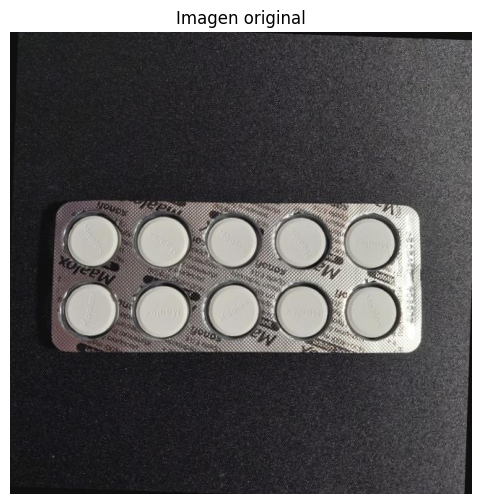

Resumen de 20250224_163348_jpg.rf.be5b44247aeb54dd8211edc21fb67aae.jpg: (0, 0)


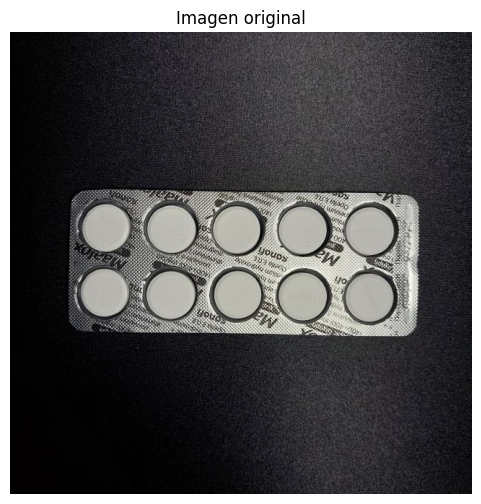

Resumen de 20250224_163425_jpg.rf.ef59285acea1a0fd6ee263c20b9022c9.jpg: (0, 0)


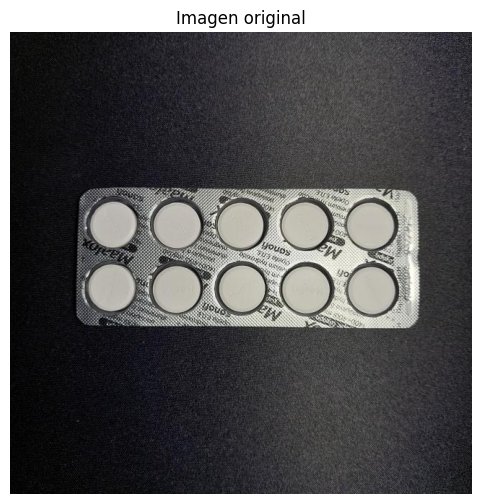

Resumen de 20250224_163601_jpg.rf.47d7c720417bbe8324321e4e47ed09ee.jpg: (0, 0)


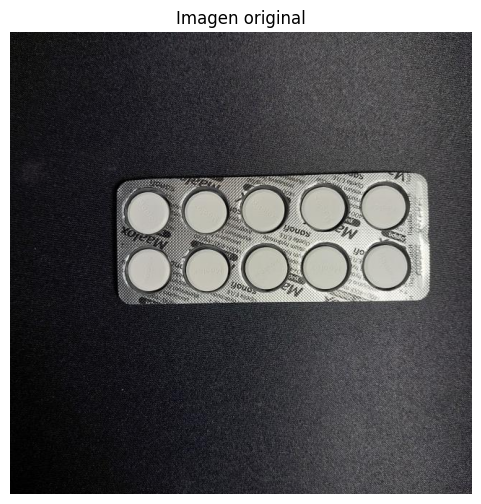

Resumen de 20250224_163622_jpg.rf.80a0a76d386947ab948ae1b7b3e65ea5.jpg: (0, 0)


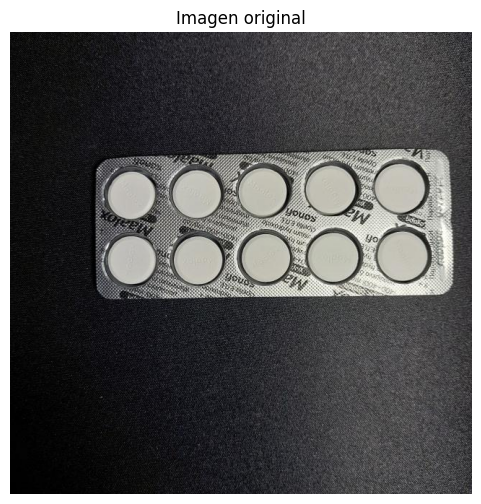

Resumen de 20250224_163623_jpg.rf.dd776684eff28cb87a62483195eed2c4.jpg: (0, 0)


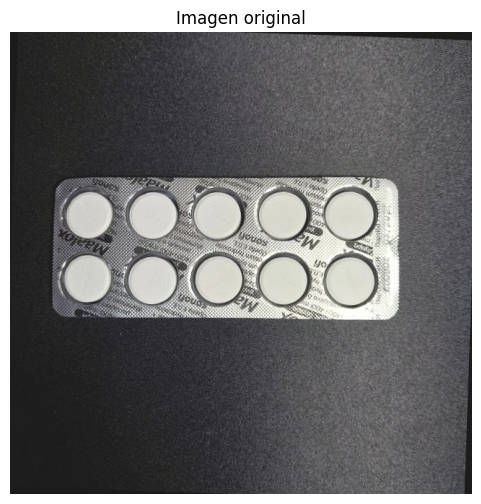

Resumen de 20250224_163630_jpg.rf.6c7a9ed1d9c08768d7082676ff0a11ba.jpg: (0, 0)


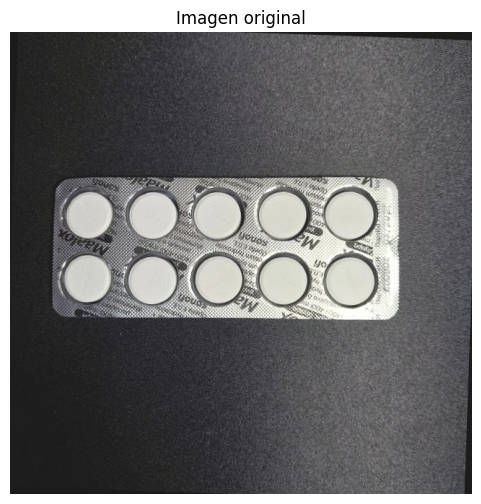

Resumen de 20250224_163630_jpg.rf.c4cd49d3a523bde6ea430037ecf3c486.jpg: (0, 0)


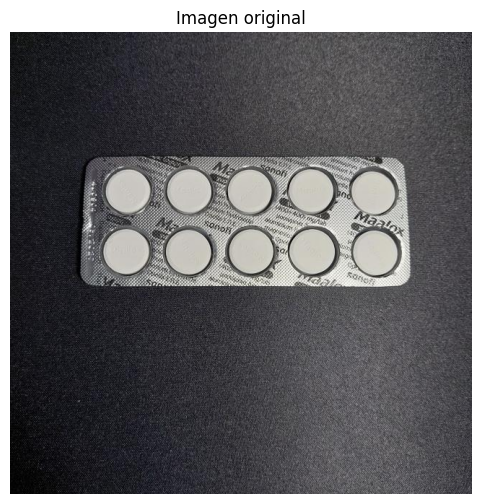

Resumen de 20250224_163717_jpg.rf.479e9666066781ae35eaf5e986122334.jpg: (0, 0)


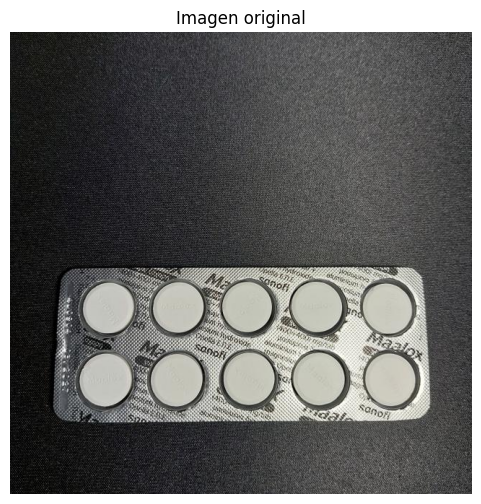

Resumen de 20250224_163759_jpg.rf.b68e618a90cc046b9f46e793bb60419d.jpg: (0, 0)


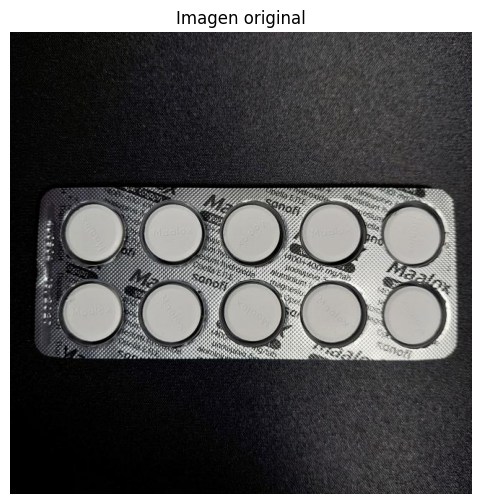

Resumen de 20250224_164025_jpg.rf.03289b44303b633c5ad34a4badafa900.jpg: (0, 0)


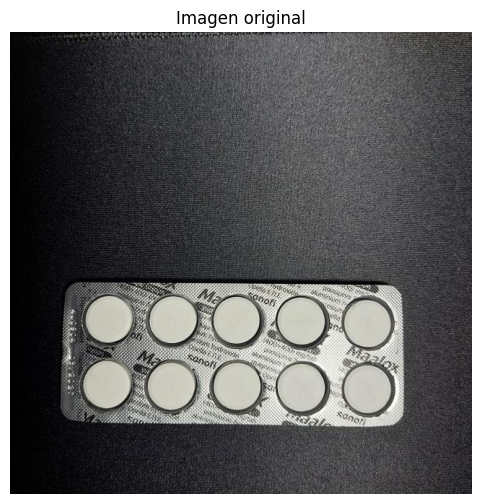

Resumen de 20250224_164357_jpg.rf.d5431377c514e1fd4735aa85d9ea7d63.jpg: (0, 0)


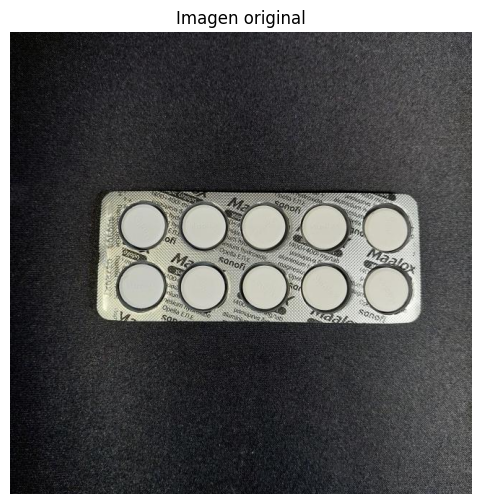

Resumen de 20250224_164729_jpg.rf.99ca294a4a7ad22ae487ca6fc3293dc5.jpg: (0, 0)


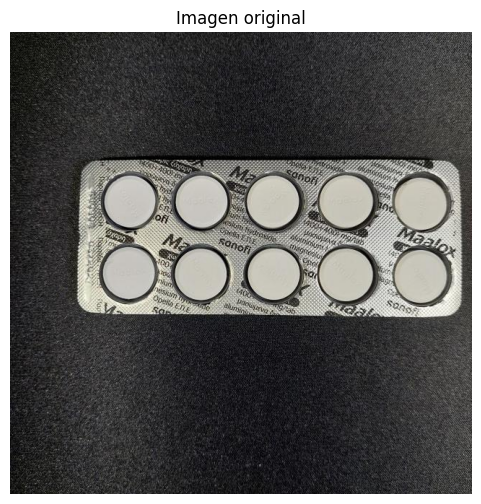

Resumen de 20250224_164755_jpg.rf.fdd8003ca31775d4ed30584e92e57527.jpg: (0, 0)


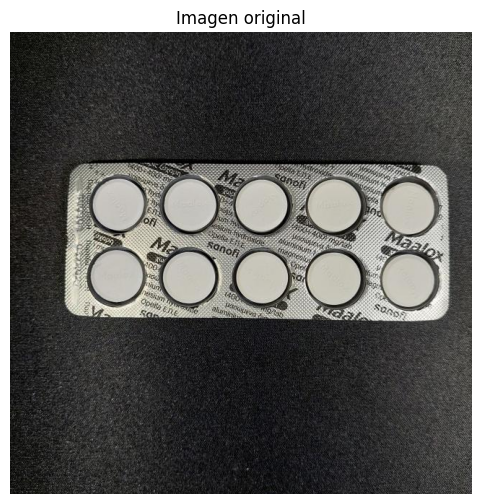

Resumen de 20250224_164757_jpg.rf.e318a5947754916d5118657478bf443d.jpg: (0, 0)


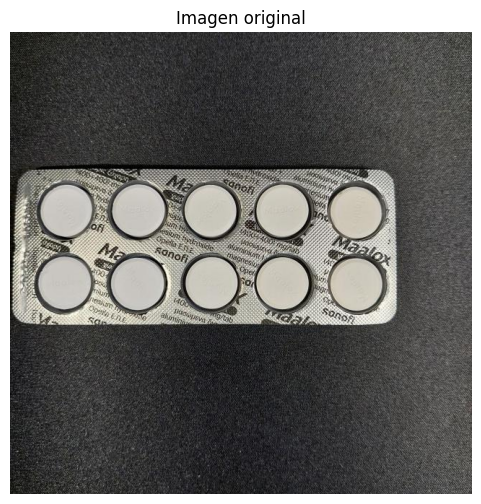

Resumen de 20250224_164800_jpg.rf.71c40bc2fbcccf0b280d683a822ed0e8.jpg: (0, 0)


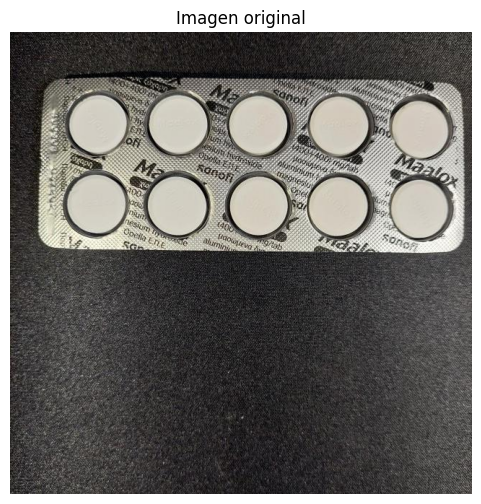

Resumen de 20250224_164807_jpg.rf.5ca80fd5be48af123a470c53e00f3e30.jpg: (0, 0)


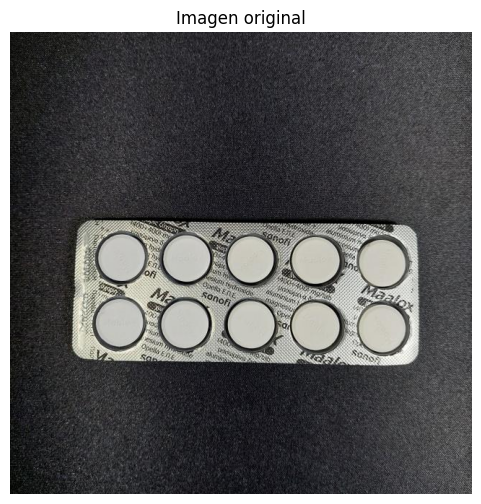

Resumen de 20250224_164816_jpg.rf.3b3f7d599d7bdda0732683ad4554853c.jpg: (0, 0)


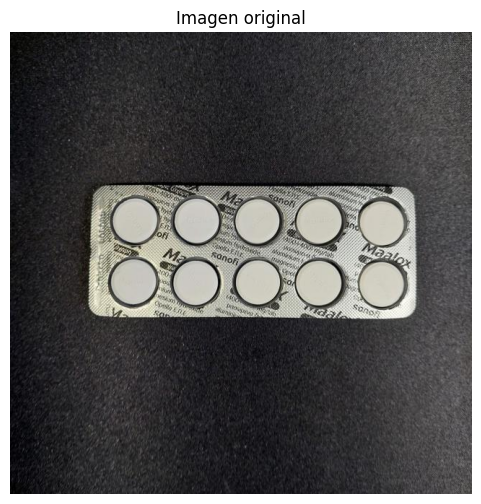

Resumen de 20250224_164819_jpg.rf.f8a65c56c7214aa36145a7ff84b77100.jpg: (0, 0)


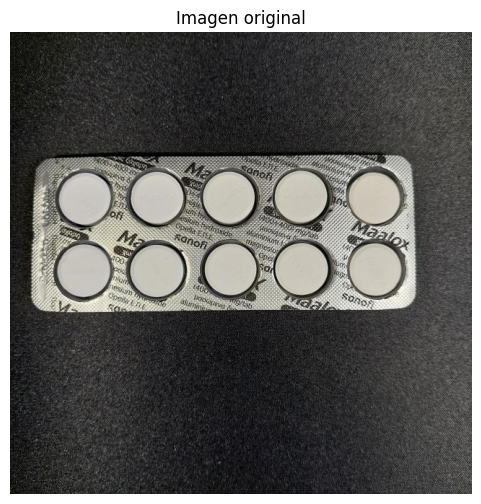

Resumen de 20250224_164823_jpg.rf.309662d6cd0e8302d3c6562d527b4353.jpg: (0, 0)


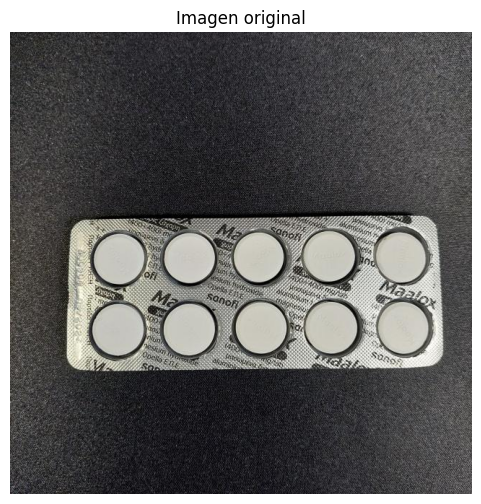

Resumen de 20250224_165021_jpg.rf.048d642ae1394dade8f11880b7cfeb56.jpg: (0, 0)


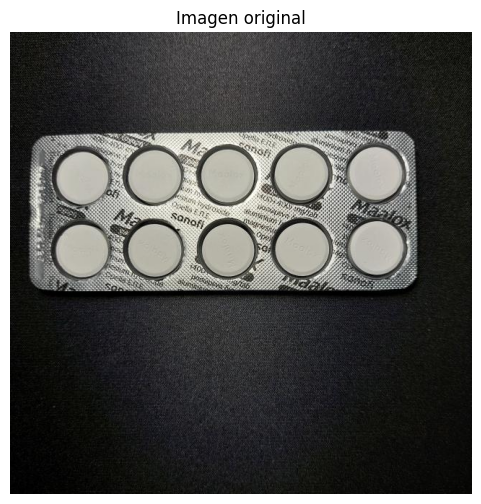

Resumen de 20250225_150119_jpg.rf.828ba3e2d817fa8285164929c8b94e07.jpg: (0, 0)


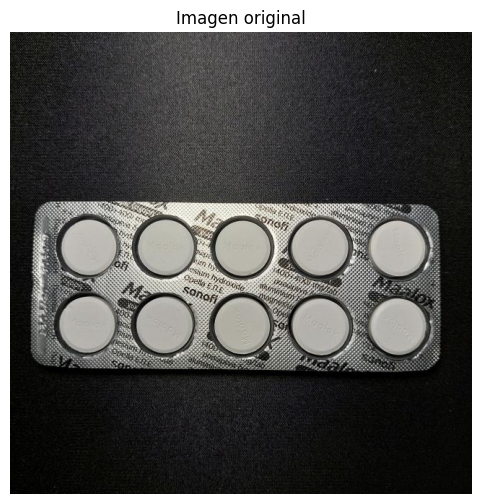

Resumen de 20250225_150124_jpg.rf.b593f1d9a18ed31fcec4b1b2526e6d95.jpg: (0, 0)


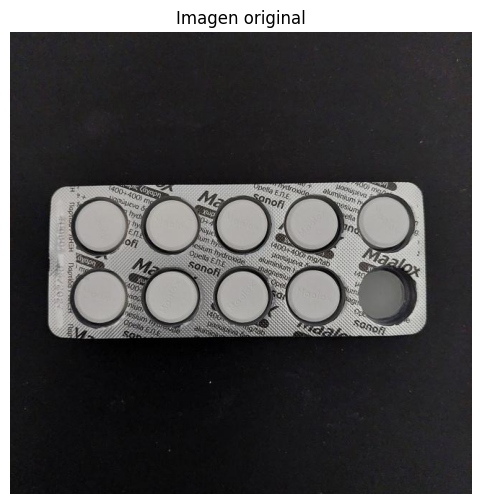

Resumen de 20250225_150913_jpg.rf.735d2986074d8cbd6784dac70928c09f.jpg: (1, 0)


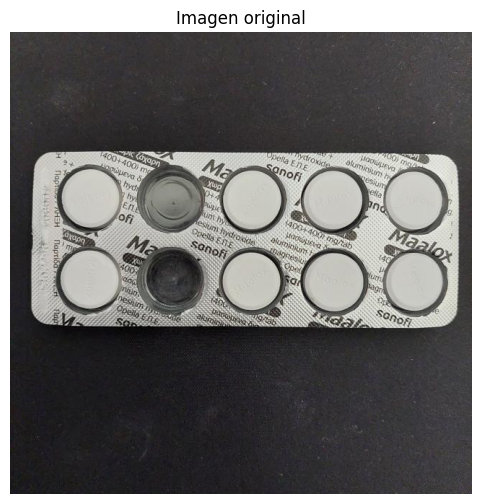

Resumen de 20250225_150948_jpg.rf.471053297abfa0e6962fc533e7c3eb6f.jpg: (2, 0)


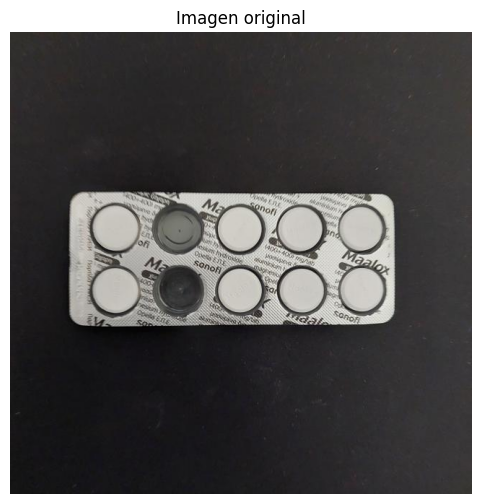

Resumen de 20250225_150956_jpg.rf.c120be6fdacd920f7b8ff0be4f6c83ed.jpg: (2, 0)


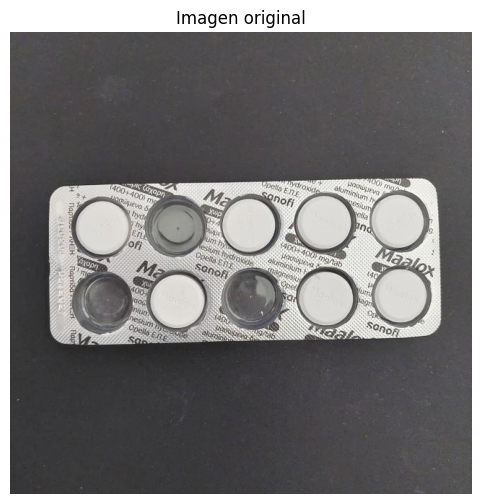

Resumen de 20250225_151103_jpg.rf.46f3abe0cb9f01b41428cfce36f545c1.jpg: (2, 1)


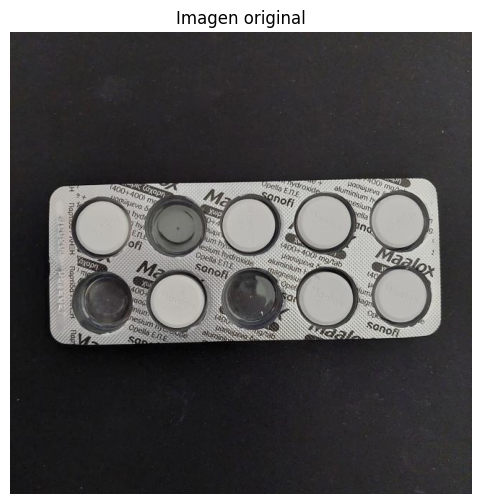

Resumen de 20250225_151103_jpg.rf.a7304fa06ec2b1297429d20f7d95062e.jpg: (3, 0)


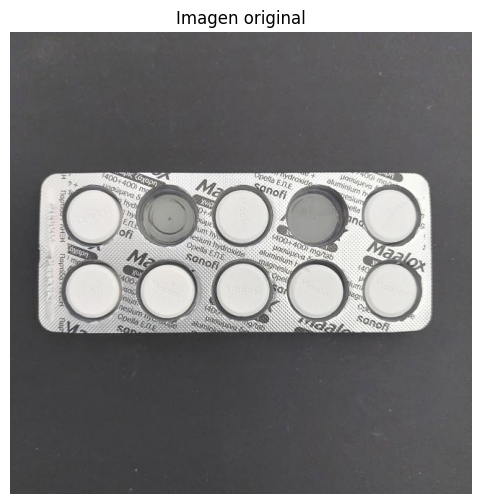

Resumen de 20250225_151137_jpg.rf.1c571d7f6c45c58fc48d196b5f8c056b.jpg: (0, 1)


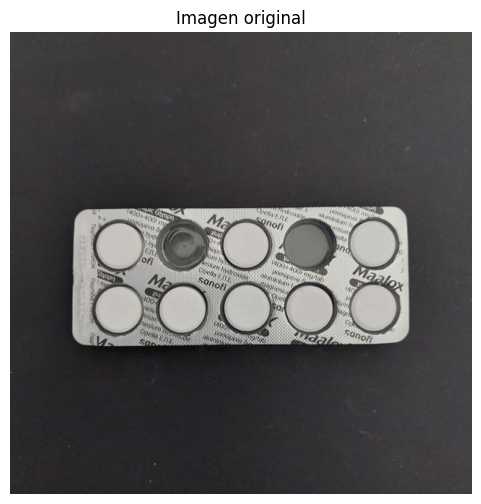

Resumen de 20250225_151139_jpg.rf.c95cb5a6d7aa80839538dd151dea63e4.jpg: (2, 0)


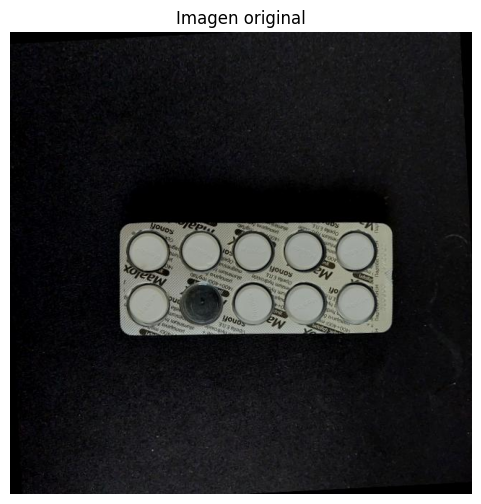

Resumen de 20250225_151217_jpg.rf.0680d2826f9d9d4199e3f17d6d759909.jpg: (1, 0)


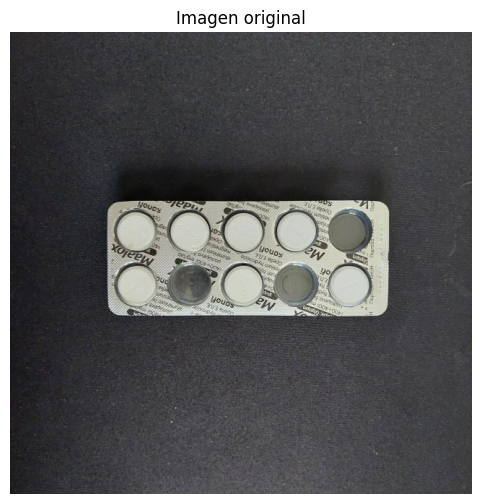

Resumen de 20250225_151245_jpg.rf.83267c2741ec28018396ec35f5f9e2f3.jpg: (3, 0)


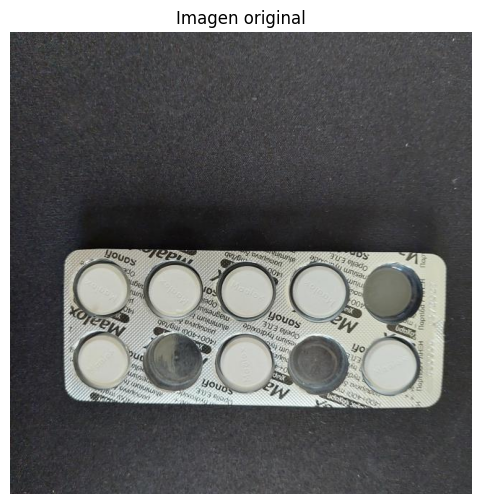

Resumen de 20250225_151254_jpg.rf.0e7bcfc8052168143bd6572657baaf1a.jpg: (3, 0)


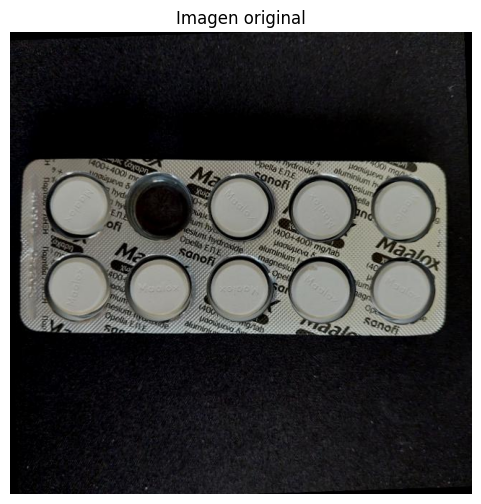

Resumen de 20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88.jpg: (1, 1)


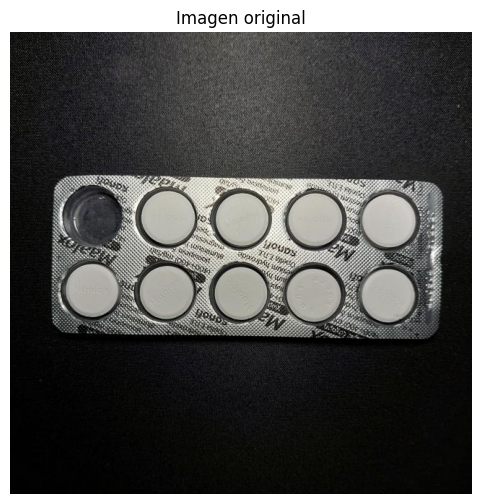

Resumen de 20250225_151540_jpg.rf.4a61307bacfb8f380afb439a4df38ca1.jpg: (1, 0)


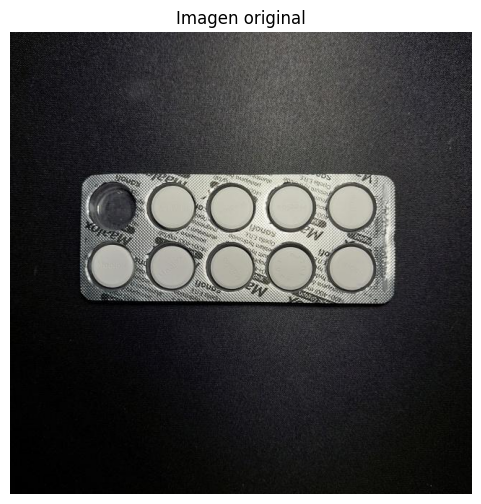

Resumen de 20250225_151543_jpg.rf.709b0ce931a67fb1eefae042b38697d1.jpg: (1, 0)


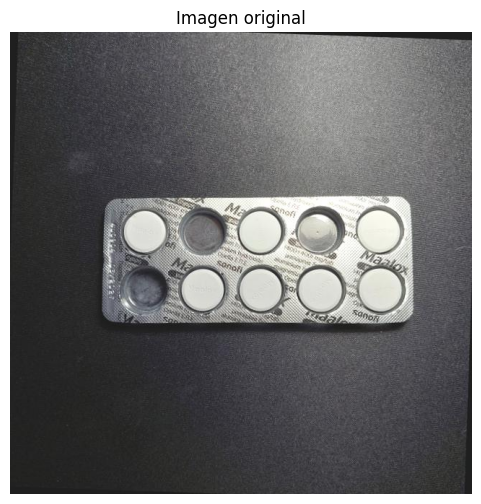

Resumen de 20250225_151859_jpg.rf.062436a1768689c95e016f40c2dd50a8.jpg: (2, 1)


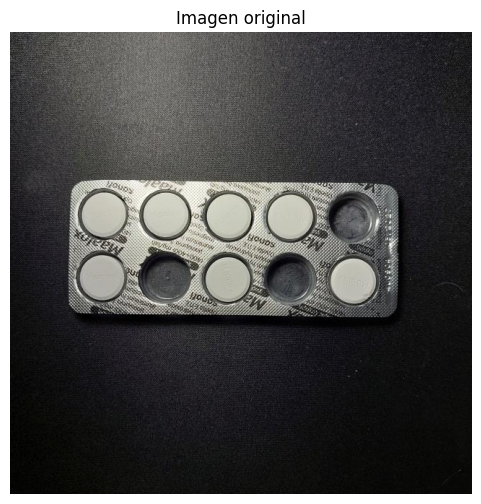

Resumen de 20250225_152024_jpg.rf.1ae8e1766afef1286f443e0868ba6c23.jpg: (3, 0)


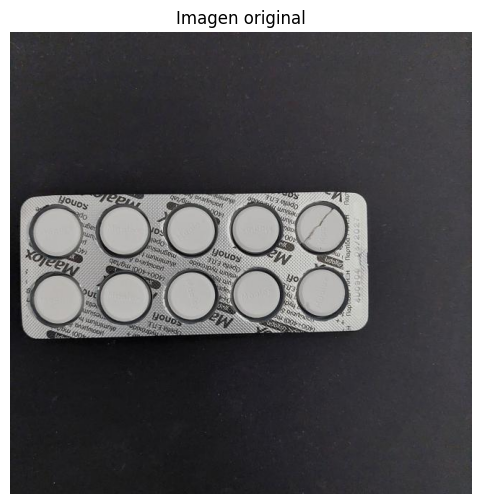

Resumen de 20250225_154108_jpg.rf.fd0abdd51d8af90df75d79419f96d5f5.jpg: (0, 1)


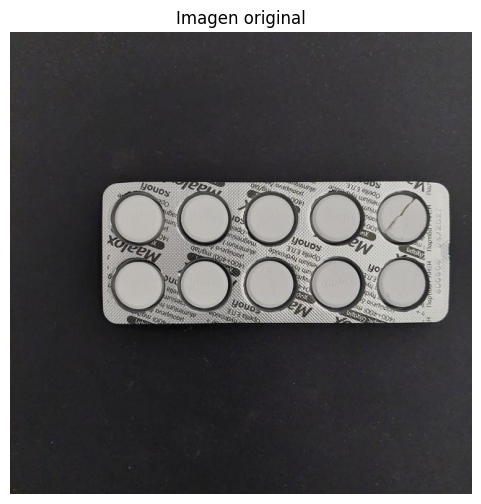

Resumen de 20250225_154112_jpg.rf.12744b95534d43330cde2165ffa20e76.jpg: (0, 1)


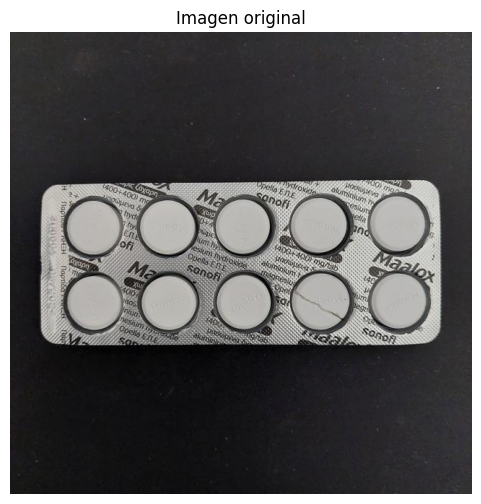

Resumen de 20250225_154404_jpg.rf.494a7871e901083dbcb8b7393a4711be.jpg: (0, 1)


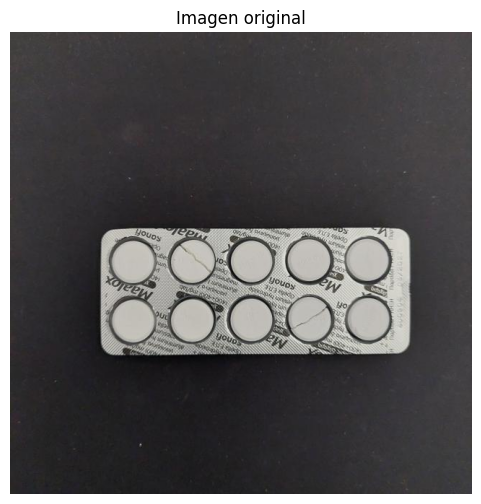

Resumen de 20250225_154528_jpg.rf.371f38e4c0a2aff26016b3427ddb0b25.jpg: (0, 2)


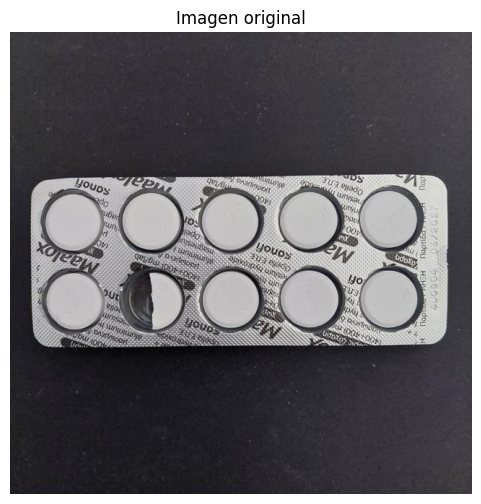

Resumen de 20250225_161141_jpg.rf.5574a442c3ae9aab79708b27b7541948.jpg: (0, 1)


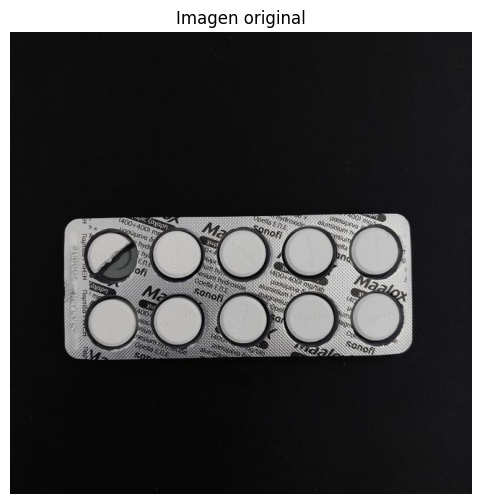

Resumen de 20250225_161304_jpg.rf.b57658709e5902fd290411fbad65657d.jpg: (0, 1)


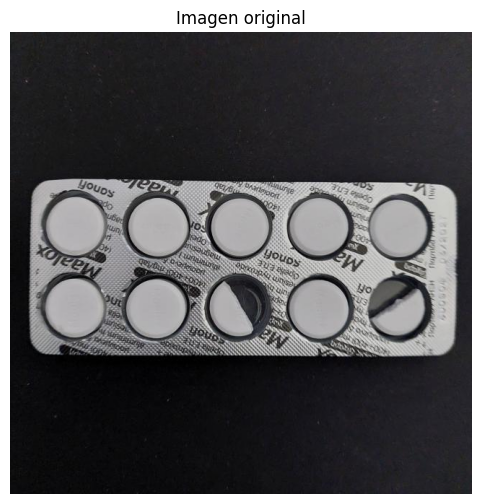

Resumen de 20250225_161552_jpg.rf.9ba490255f38f38e31a0524862161563.jpg: (0, 2)


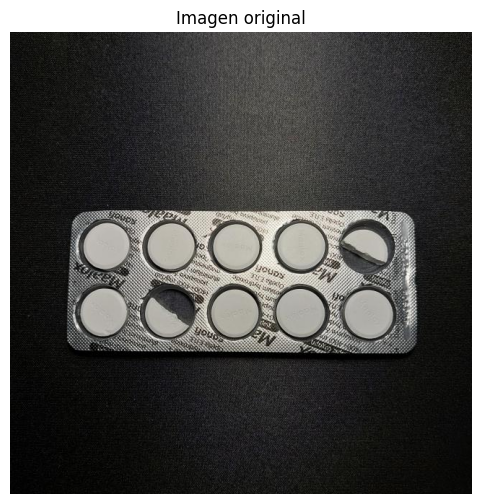

Resumen de 20250225_164532_jpg.rf.61ffd46aaa9573294494a0b18fc54a66.jpg: (0, 2)


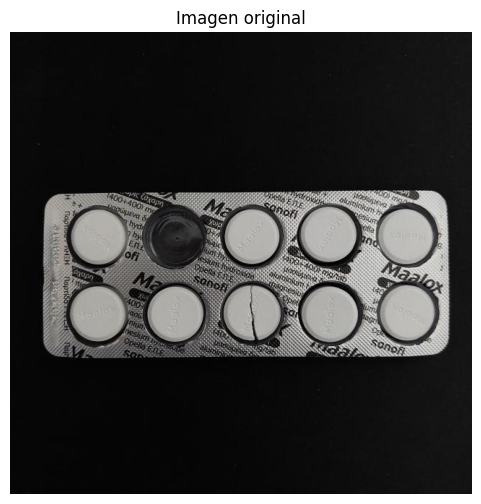

Resumen de 20250225_165624_jpg.rf.1e4a8832a7e0f141efad97260b9c732d.jpg: (1, 1)


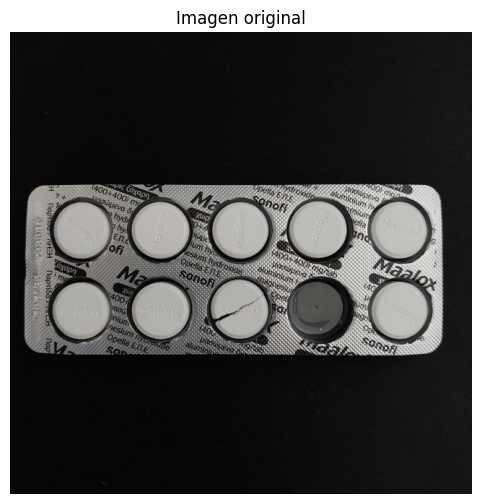

Resumen de 20250225_165928_jpg.rf.90f291475d3fe4f2009933e1191bdb6e.jpg: (1, 1)


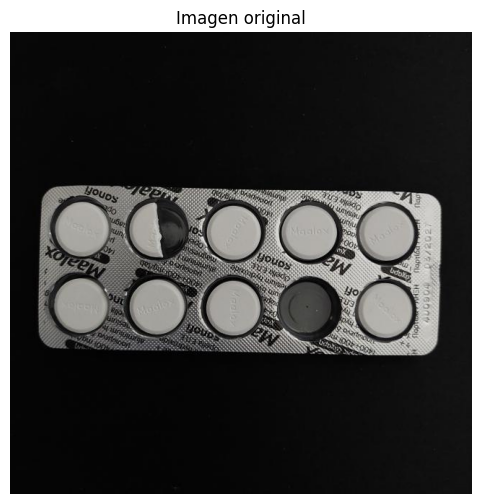

Resumen de 20250225_170045_jpg.rf.b1e64bd64417c5964042f2958d2c4eff.jpg: (1, 2)


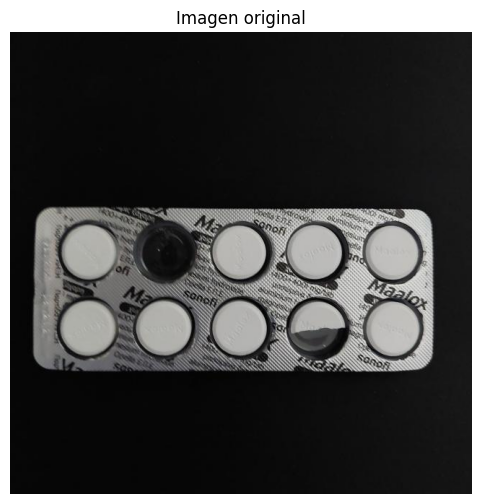

Resumen de 20250225_170053_jpg.rf.dcbb4f70eff7f4529a2b7b8a1e8445c5.jpg: (1, 1)


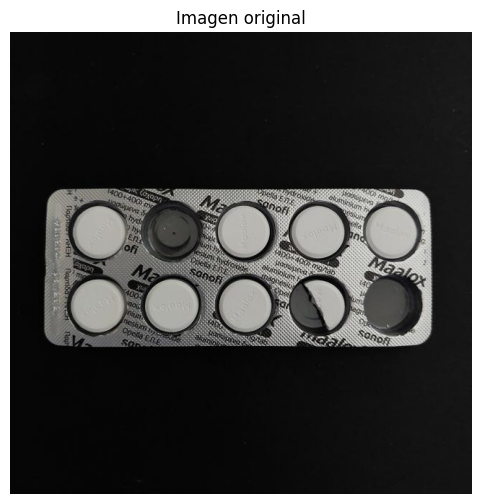

Resumen de 20250225_170111_jpg.rf.97d8a1e20025d109dc89e6a0659353e1.jpg: (2, 1)


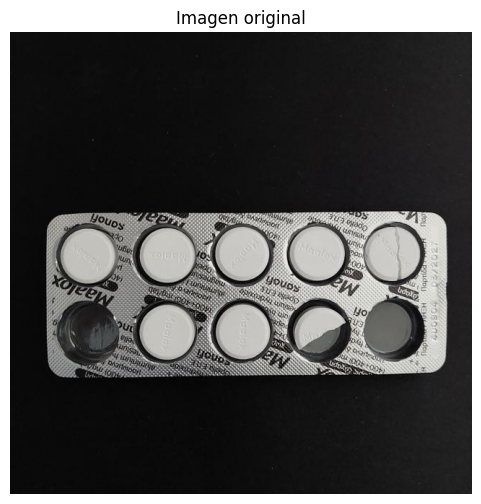

Resumen de 20250225_170526_jpg.rf.003ebc0d88afd130afb3385ee759fcca.jpg: (2, 2)


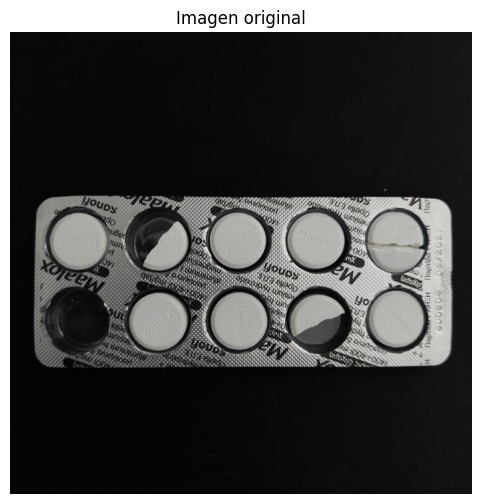

Resumen de 20250225_170642_jpg.rf.679b22da021ece3d786c4781cb4f8cb4.jpg: (1, 3)


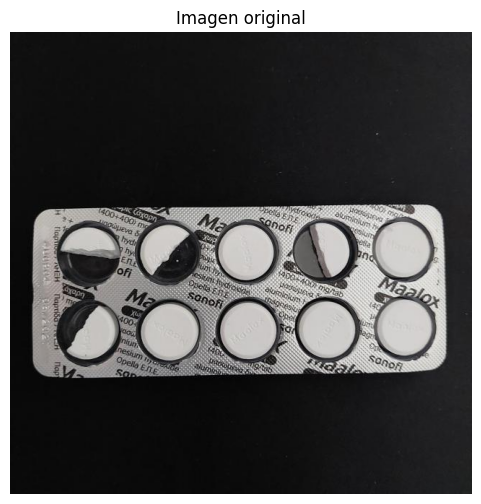

Resumen de 20250225_171024_jpg.rf.97c270f659864f7acb5568b7ae2f068b.jpg: (0, 4)


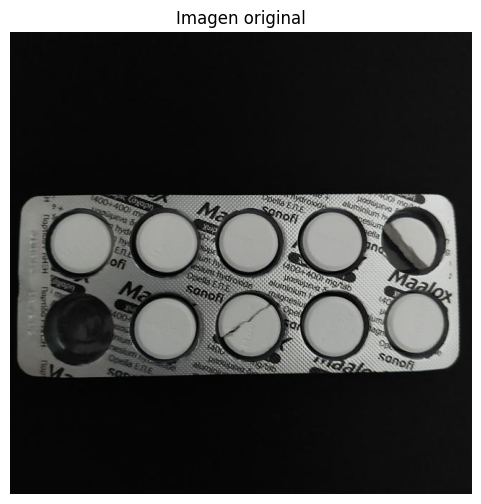

Resumen de 20250225_171657_jpg.rf.42b689580e5dd270e391c45293083ab7.jpg: (1, 2)


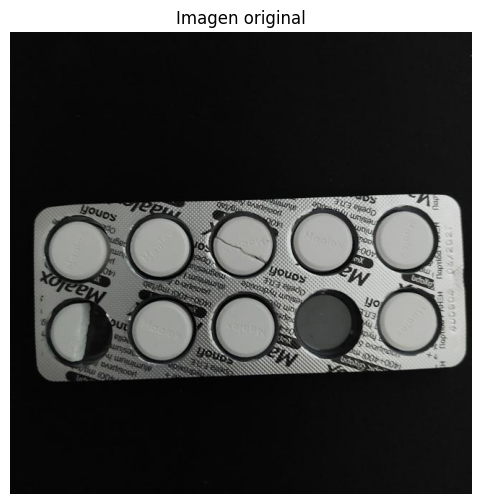

Resumen de 20250225_171725_jpg.rf.9030d574488045eedb55112192a56bb2.jpg: (1, 2)


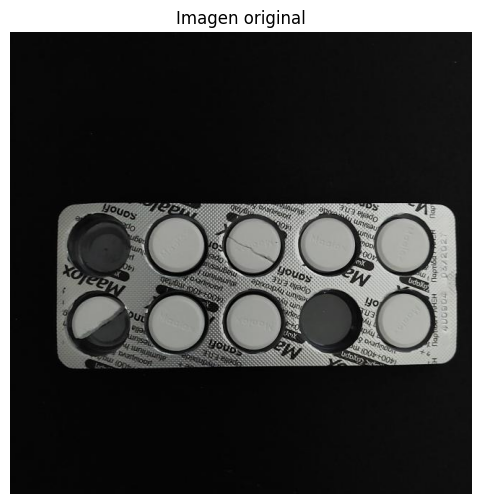

Resumen de 20250225_171734_jpg.rf.7a448fb806ae22762e1fa55a4b515633.jpg: (3, 1)


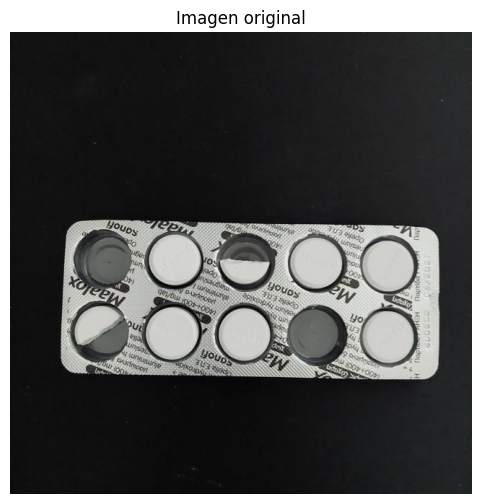

Resumen de 20250225_171749_jpg.rf.bcfeef21f8c4e541914265f8faf79fb2.jpg: (2, 2)


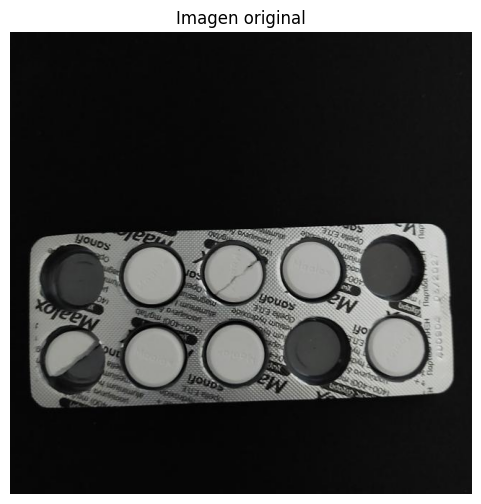

Resumen de 20250225_171805_jpg.rf.3e4e56eb7116a5bccfa145fe4c74a3ab.jpg: (3, 2)


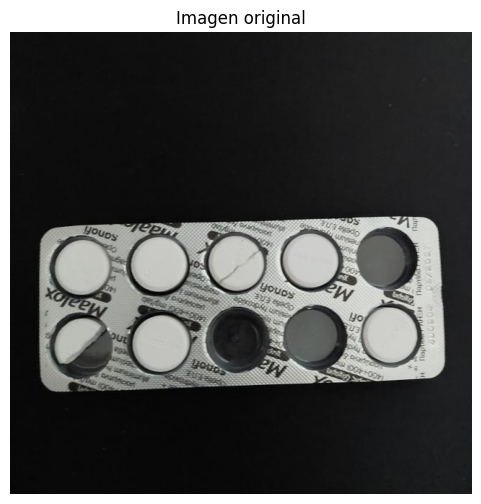

Resumen de 20250225_171848_jpg.rf.a63d395f50938a9019e634b1e15b15a1.jpg: (3, 2)


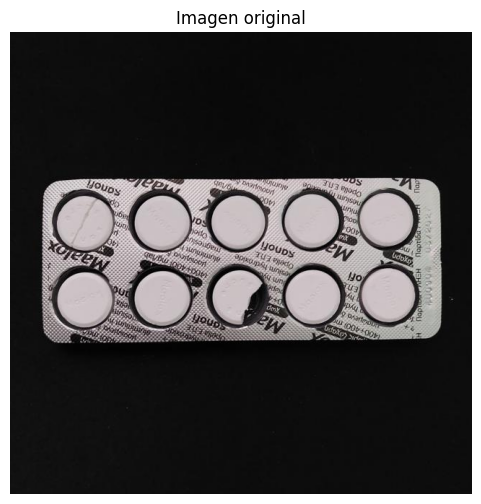

Resumen de 20250312_165803_jpg.rf.b23627621808796f3a5768fa962a831f.jpg: (0, 2)


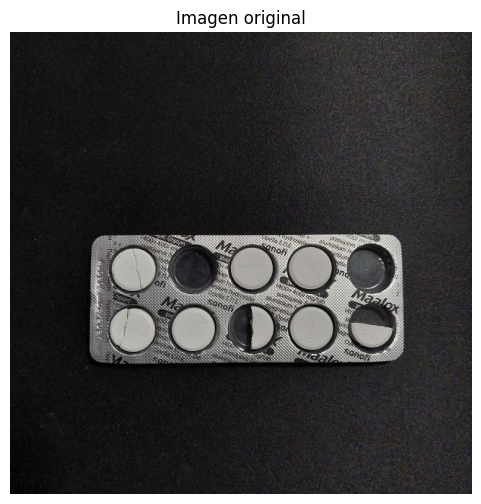

Resumen de 20250312_171405_jpg.rf.f9912a7abc226718ea46235a99d1f1b4.jpg: (2, 4)


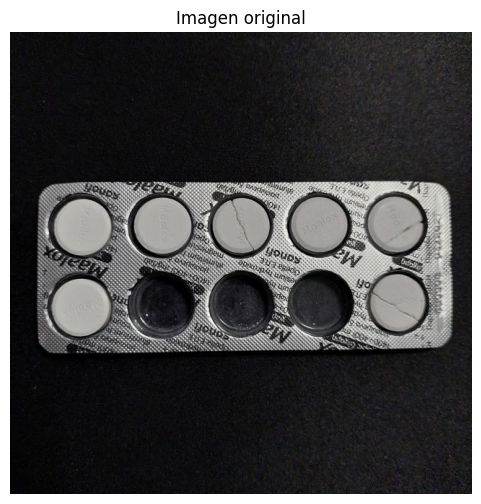

Resumen de 20250312_171509_jpg.rf.eeb91672439923aff235e176cd1e026f.jpg: (3, 3)


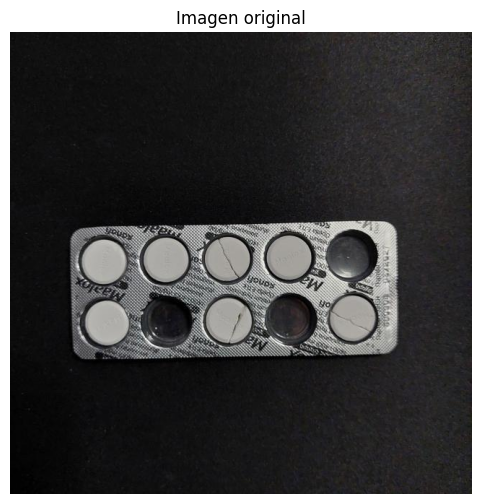

Resumen de 20250312_171529_jpg.rf.8e9d3150799d6e5e0a6ceed59bc58a84.jpg: (3, 3)


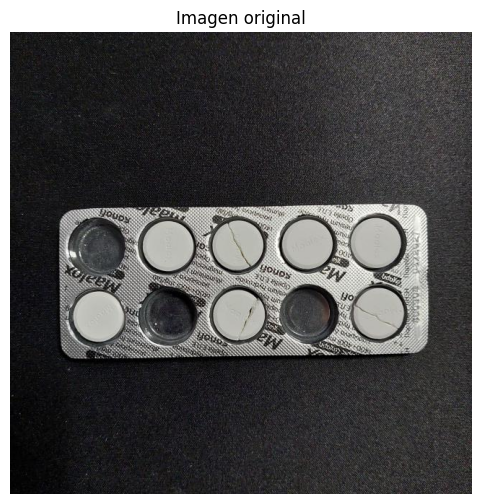

Resumen de 20250312_171539_jpg.rf.1add4b5396aba0cecf9e72546887c1aa.jpg: (3, 3)


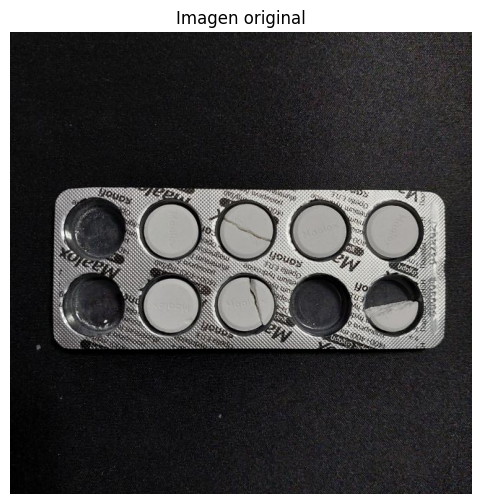

Resumen de 20250312_171642_jpg.rf.385bb55d9b323381cd7ff62d30d99092.jpg: (3, 3)


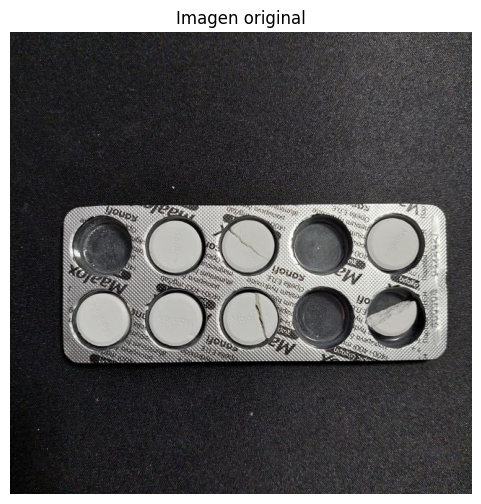

Resumen de 20250312_171700_jpg.rf.3c726cccd70bddc558b2b278c5bd284c.jpg: (3, 3)


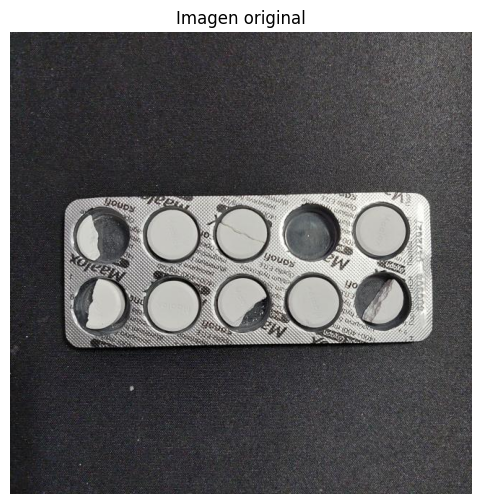

Resumen de 20250312_171824_jpg.rf.1134a98874918268298d8871aa33588a.jpg: (1, 5)


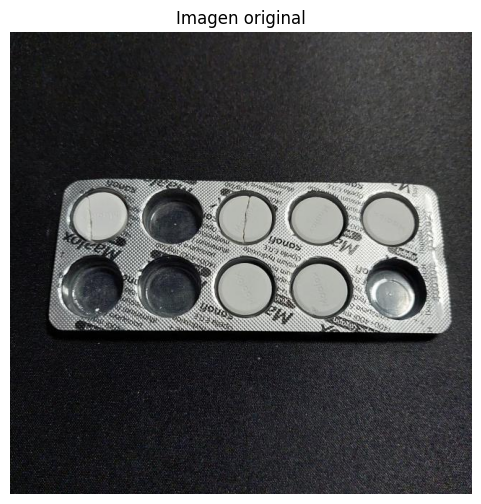

Resumen de 20250312_172022_jpg.rf.2c3f0762f8e452abc9a26f1461adcdce.jpg: (3, 3)


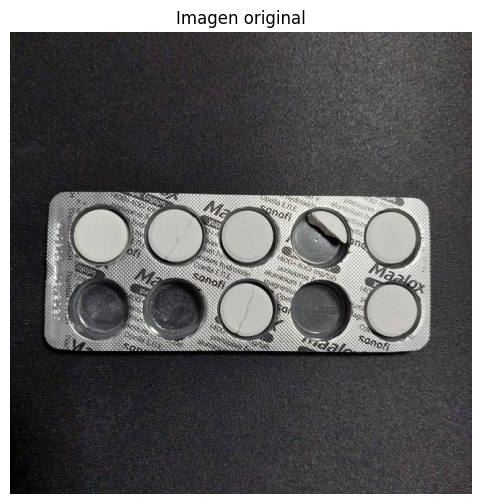

Resumen de 20250312_172359_jpg.rf.60234149154ea84176086082f3682819.jpg: (4, 2)


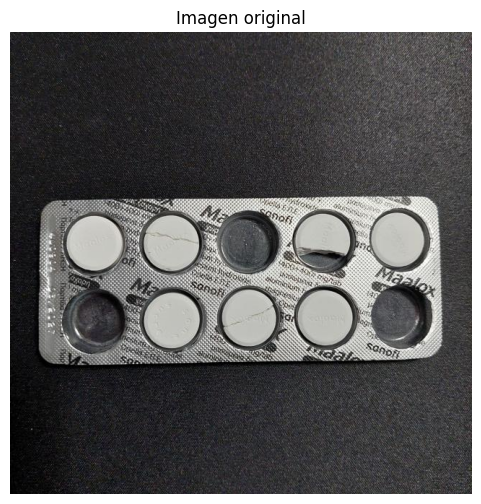

Resumen de 20250312_172712_jpg.rf.21380d295220517e61e78e18e8b2ab18.jpg: (3, 3)


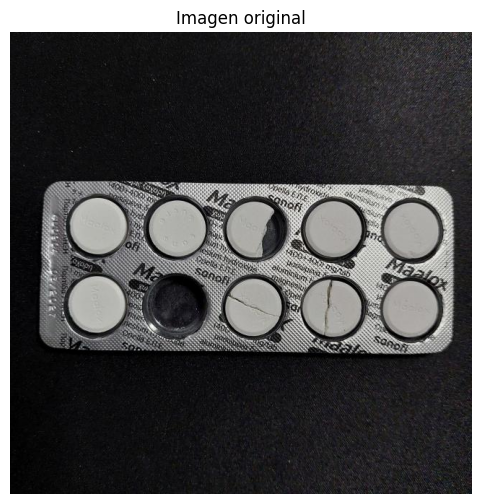

Resumen de 20250312_173113_jpg.rf.6eb41a18735d11eb5db67be57a921f32.jpg: (1, 3)


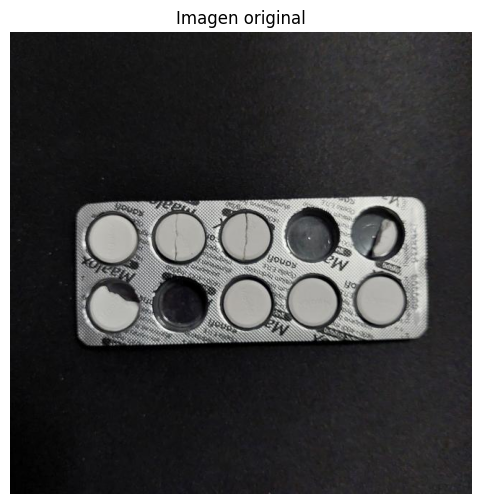

Resumen de 20250312_173454_jpg.rf.d260cc844542c7f0e853c212cc66fcfb.jpg: (3, 3)


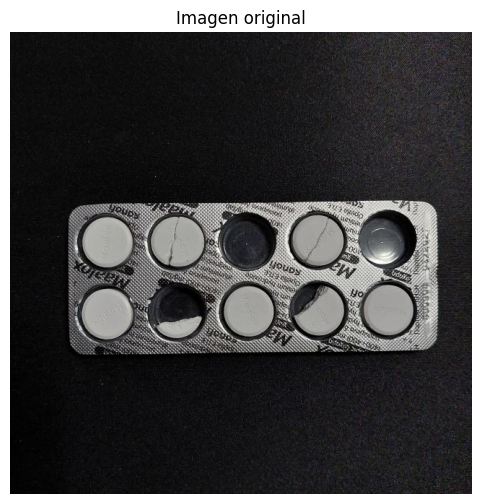

Resumen de 20250312_173631_jpg.rf.7c0f651e5b870507a6bb587e70c89a22.jpg: (2, 4)


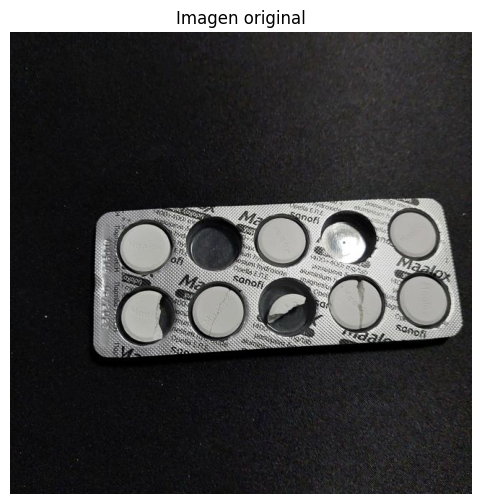

Resumen de 20250312_173711_jpg.rf.1573423577f218f012d5df2c93997d9c.jpg: (2, 4)


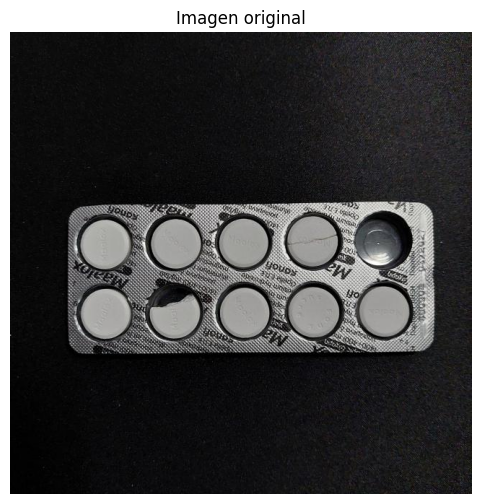

Resumen de 20250312_173844_jpg.rf.e0363150be9ff3d434ab98ac8774b22b.jpg: (1, 2)


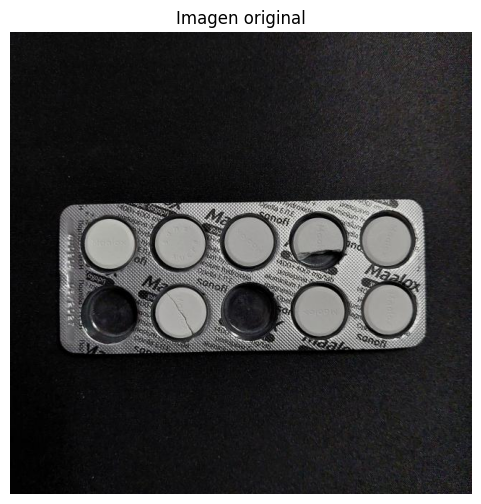

Resumen de 20250312_173916_jpg.rf.385f793dab7e08b0c6124c6aeb99d0be.jpg: (2, 2)


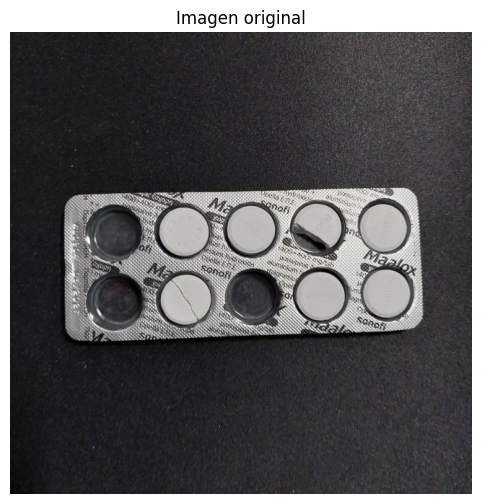

Resumen de 20250312_173925_jpg.rf.b50ba8fa6b978d59365b5b4590a8abc1.jpg: (3, 2)
Se leyeron 100 labels del archivo
Desacuerdo en 20250224_155804_jpg.rf.78db2607faf7d1e3436ca30c0e8522b0.jpg: Label=(0, 0), Detectado=(0, 6)
Desacuerdo en 20250224_155804_jpg.rf.811657b022b706b29cd562a558ba1503.jpg: Label=(0, 0), Detectado=(0, 1)
Desacuerdo en 20250225_151103_jpg.rf.46f3abe0cb9f01b41428cfce36f545c1.jpg: Label=(3, 0), Detectado=(2, 1)
Desacuerdo en 20250225_151137_jpg.rf.1c571d7f6c45c58fc48d196b5f8c056b.jpg: Label=(2, 0), Detectado=(0, 1)
Desacuerdo en 20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88.jpg: Label=(1, 0), Detectado=(1, 1)
Desacuerdo en 20250225_151859_jpg.rf.062436a1768689c95e016f40c2dd50a8.jpg: Label=(3, 0), Detectado=(2, 1)
Desacuerdo en 20250225_170045_jpg.rf.b1e64bd64417c5964042f2958d2c4eff.jpg: Label=(1, 1), Detectado=(1, 2)
Desacuerdo en 20250225_171734_jpg.rf.7a448fb806ae22762e1fa55a4b515633.jpg: Label=(2, 2), Detectado=(3, 1)
Desacuerdo en 20250312_172022_jpg.rf.2c

In [86]:
#Recorrer varias imagenes
import os
resumen_imagenes = []
image_folder = "img_depurado"
for filename in os.listdir(image_folder):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        image_path = os.path.join(image_folder, filename) #ruta completa
        img = cv2.imread(image_path) #cargar imagen
        imshow("Imagen original", img)
    gray_blister_clahe,blister_crop=find_edges(img) #Detección de blister
    #imshow("Blister con CLAHE (contraste aumentado)", gray_blister_clahe)   
    #Detección de pastilas
    circles = cv2.HoughCircles(gray_blister_clahe,cv2.HOUGH_GRADIENT,dp=1,minDist=75,param1=100,param2=10,minRadius=25,maxRadius=35)
    blister_circles_vis = gray_blister_clahe.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles[0]))
        for (x_c, y_c, r_c) in circles:
            cv2.circle(blister_circles_vis, (x_c, y_c), r_c, (255, 0, 0), 2)
            #print(f"Círculo de radio {r_c}")
    else:
        circles = []
        #print("No se detectaron cavidades.")
    #Clasificación
    resultados_2=clasificar(gray_blister_clahe,circles)
    #pastillas_ordendas(resultados_2)
    #Encontrar rotas/incompletas
    resultados_2=rotas_incompletas(resultados_2,gray_blister_clahe)
    # Contar estados
    #completa = sum(1 for r in resultados_2 if r['estado'] == "completa")
    vacia = sum(1 for r in resultados_2 if r['estado'] == "vacía")
    rota_incompleta = sum(1 for r in resultados_2 if r['estado'] == "rota/incompleta")

    # Crear tupla ordenada
    resumen = (vacia, rota_incompleta)
    print(f"Resumen de {filename}: {resumen}")

    # Guardar en la lista de resultados
    resumen_imagenes.append((filename, resumen))
    
#labels_file = "dataset/label_rotas_prueba"  # ruta a tu archivo de labels

# Leer labels
labels_dict = {}
labels_file ="label_rotas.txt"
try:
    with open(labels_file, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue
            nombre, tupla_str = line.split(":")
            tupla = tuple(map(int, tupla_str.strip("()").split(",")))  # convertir a tupla
            labels_dict[nombre.strip()] = tupla
    print(f"Se leyeron {len(labels_dict)} labels del archivo")
except FileNotFoundError:
    print(f"No se encontró el archivo: {labels_file}")
aciertos = 0
total = len(resumen_imagenes)
desacuerdos = []

for nombre_img, detected_tuple in resumen_imagenes:
    if nombre_img in labels_dict:
        vacias_label, rotas_label = labels_dict[nombre_img]
        vacias_detected, rotas_detected = detected_tuple
        if vacias_label == vacias_detected and rotas_label == rotas_detected:
            aciertos += 1
        else:
            print(f"Desacuerdo en {nombre_img}: Label={labels_dict[nombre_img]}, Detectado={detected_tuple}")
            desacuerdos.append({
                "imagen": nombre_img,
                "label": labels_dict[nombre_img],
                "detectado": detected_tuple
            })
    else:
        print(f"No se encontró label para {nombre_img}")

print(f"\nTotal imágenes: {total}")
print(f"Aciertos exactos: {aciertos}")
print(f"Exactitud: {aciertos/total*100:.2f}%")

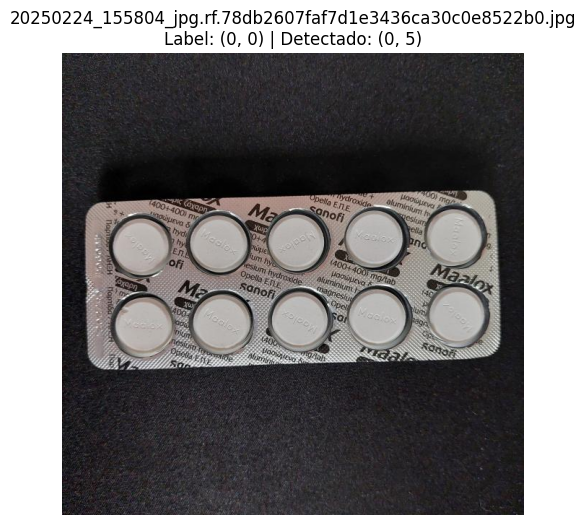

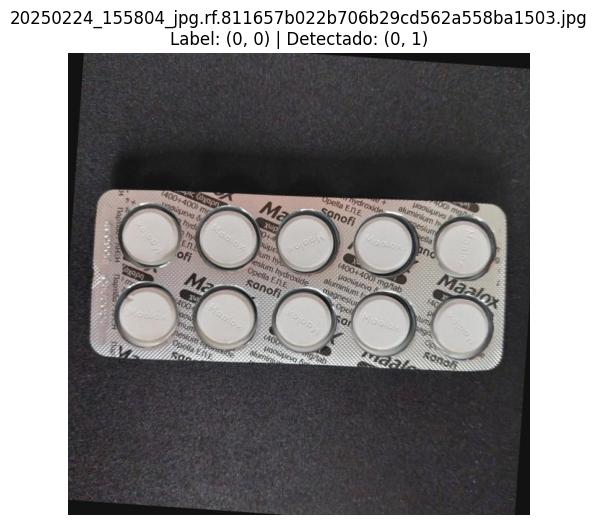

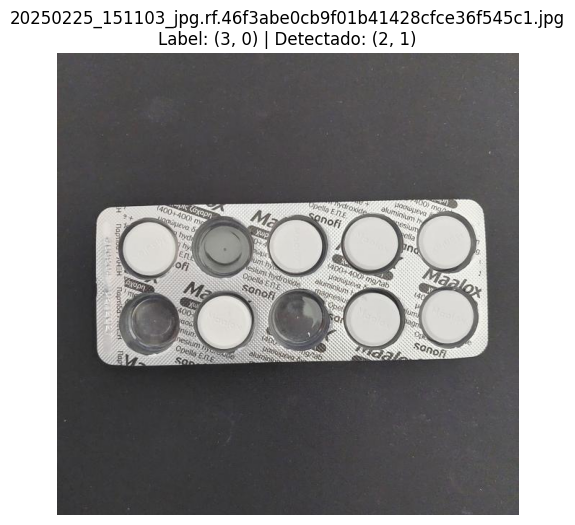

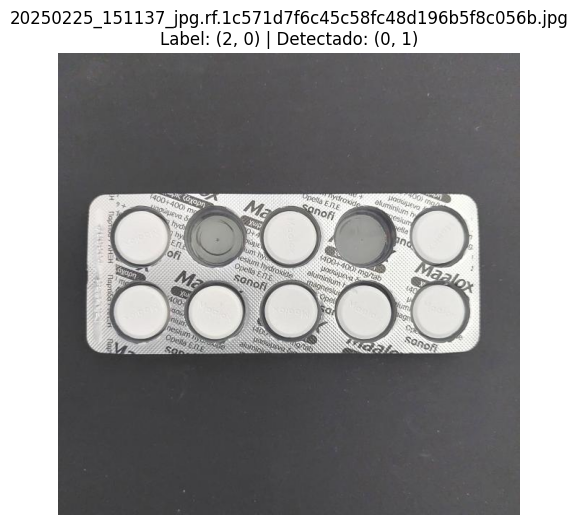

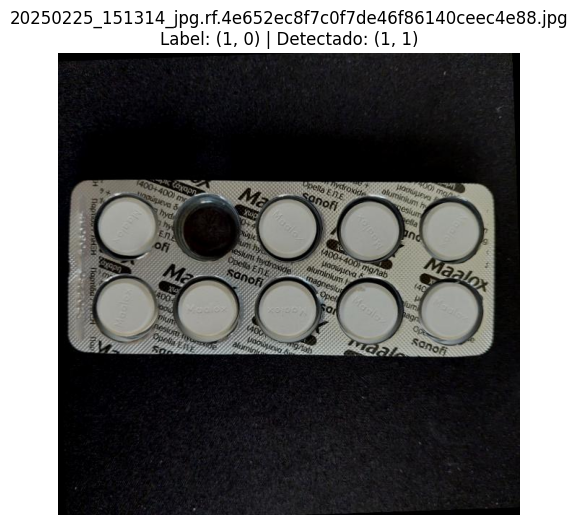

...

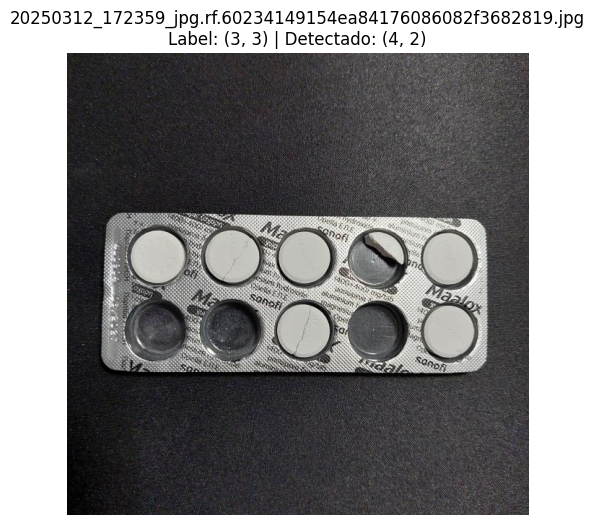

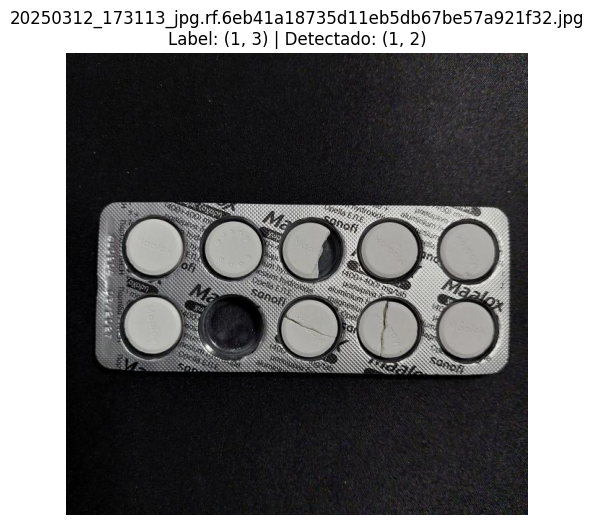

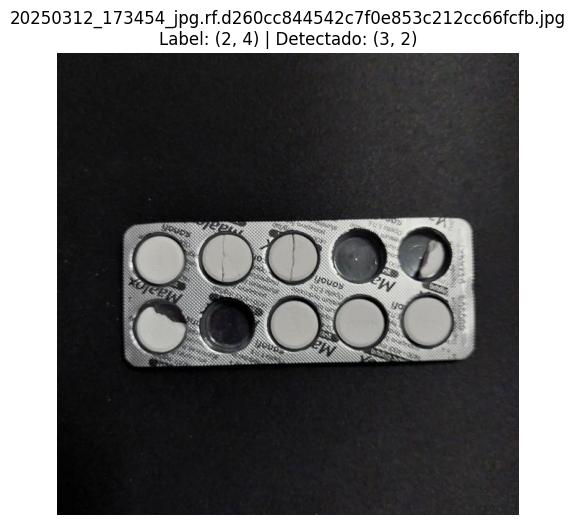

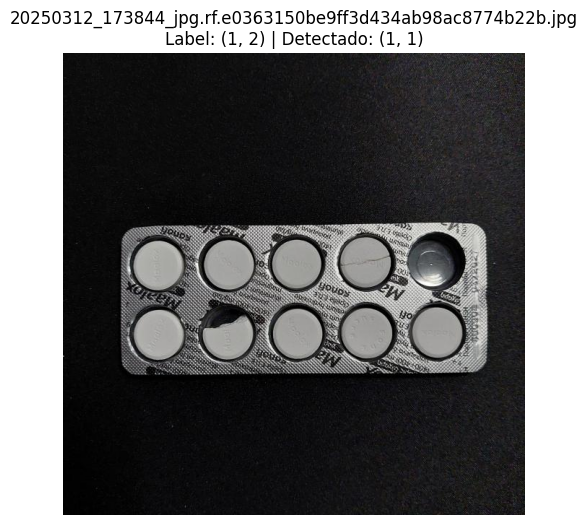

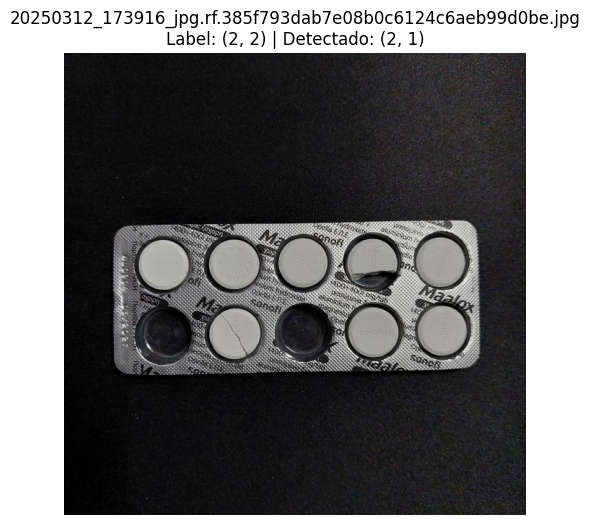

In [7]:
for item in desacuerdos:

    nombre_img = item["imagen"]
    label = item["label"]
    detectado = item["detectado"]

    img_path = os.path.join(image_folder, nombre_img)
    img = cv2.imread(img_path)

    if img is None:
        print(f"No se pudo cargar: {img_path}")
        continue

    titulo = (
        f"{nombre_img}\n"
        f"Label: {label} | Detectado: {detectado}"
    )

    imshow(titulo, img)

In [8]:
output_folder = "desacuerdos_img"
os.makedirs(output_folder, exist_ok=True)

for item in desacuerdos:

    nombre_img = item["imagen"]
    label = item["label"]
    detectado = item["detectado"]

    img_path = os.path.join(image_folder, nombre_img)
    img = cv2.imread(img_path)

    if img is None:
        print(f"No se pudo cargar: {img_path}")
        continue

    # Nombre del archivo guardado
    new_name = f"{os.path.splitext(nombre_img)[0]}_L{label}_D{detectado}.png"
    save_path = os.path.join(output_folder, new_name)

    cv2.imwrite(save_path, img)
    print(f"Guardada: {save_path}")


Guardada: desacuerdos_img\20250224_155804_jpg.rf.78db2607faf7d1e3436ca30c0e8522b0_L(0, 0)_D(0, 5).png
Guardada: desacuerdos_img\20250224_155804_jpg.rf.811657b022b706b29cd562a558ba1503_L(0, 0)_D(0, 1).png
Guardada: desacuerdos_img\20250225_151103_jpg.rf.46f3abe0cb9f01b41428cfce36f545c1_L(3, 0)_D(2, 1).png
Guardada: desacuerdos_img\20250225_151137_jpg.rf.1c571d7f6c45c58fc48d196b5f8c056b_L(2, 0)_D(0, 1).png
Guardada: desacuerdos_img\20250225_151314_jpg.rf.4e652ec8f7c0f7de46f86140ceec4e88_L(1, 0)_D(1, 1).png
Guardada: desacuerdos_img\20250225_151859_jpg.rf.062436a1768689c95e016f40c2dd50a8_L(3, 0)_D(2, 1).png
Guardada: desacuerdos_img\20250225_170045_jpg.rf.b1e64bd64417c5964042f2958d2c4eff_L(1, 1)_D(1, 2).png
Guardada: desacuerdos_img\20250225_171734_jpg.rf.7a448fb806ae22762e1fa55a4b515633_L(2, 2)_D(3, 1).png
Guardada: desacuerdos_img\20250312_165803_jpg.rf.b23627621808796f3a5768fa962a831f_L(0, 2)_D(0, 1).png
Guardada: desacuerdos_img\20250312_172022_jpg.rf.2c3f0762f8e452abc9a26f1461adcdce_